# Employee Attrition - Exploratory Data Analysis

In [1]:
## Import Libraries
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

# get matplot to show charts inline
%matplotlib inline

In [2]:
# Display the HR dataset's column information
excel_file = 'Data/IBM-HR-Column-Desciption.xlsx' 
df0 = pd.read_excel(excel_file)

# Convert DataFrame to Markdown format
markdown_table = df0.to_markdown(index=False)

# Print the Markdown table
print(markdown_table)

# Dataset Source & Reference:
## https://www.kaggle.com/datasets/thedevastator/employee-attrition-and-factors/data?select=HR_Analytics.csv.csv
## https://www.kaggle.com/datasets/pavansubhasht/ibm-hr-analytics-attrition-dataset/data

| Column name              | Description                                                              | Data type     |
|:-------------------------|:-------------------------------------------------------------------------|:--------------|
| Age                      | The age of the employee                                                  | (Numerical)   |
| Attrition                | Whether or not the employee has left the organization                    | (Categorical) |
| BusinessTravel           | The frequency of business travel for the employee                        | (Categorical) |
| DailyRate                | The daily rate of pay for the employee                                   | (Numerical)   |
| Department               | The department the employee works in                                     | (Categorical) |
| DistanceFromHome         | The distance from home in miles for the employee                         | (Numerical)   |
| Education                | The level o

In [3]:
# Import the HR dataset:
df = pd.read_csv('Data/IBM-HR-Employee-Attrition.csv') 

## Inspect the data

In [4]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [5]:
df.tail()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8
1469,34,No,Travel_Rarely,628,Research & Development,8,3,Medical,1,2068,...,1,80,0,6,3,4,4,3,1,2


In [6]:
df.shape

(1470, 35)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [8]:
# Check for missing values
df.isna().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [9]:
# Check for duplicates
df.duplicated().sum()

0

## Overview of Company & Employee Data with Visualisations

In [10]:
# Check the target variable "Attrition"
attrition_counts = df['Attrition'].value_counts()
attrition_counts

Attrition
No     1233
Yes     237
Name: count, dtype: int64

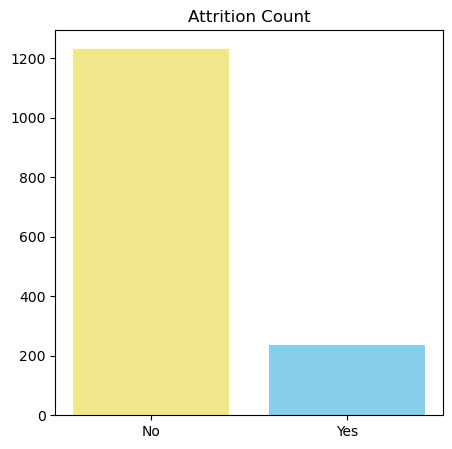

In [11]:
# Define a list of colors
colors = ['khaki', 'skyblue']  

# Plot Attrition Count
plt.figure(figsize=(5, 5))
#sns.countplot(x='Attrition', data=df, hue='Attrition', palette='viridis')
plt.bar(attrition_counts.index, attrition_counts.values, color = colors)  
plt.title('Attrition Count')
plt.show()


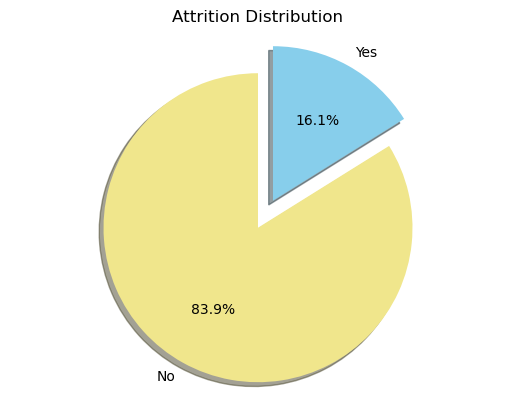

In [12]:

# Create a pie chart to show percentage
fig1, ax1 = plt.subplots()
ax1.pie(attrition_counts, 
        explode= (0.1, 0.1), 
        labels=attrition_counts.index, 
        autopct='%1.1f%%', 
        shadow=True, 
        startangle=90,
        colors=colors)

ax1.axis('equal') # Equal aspect ratio ensures that pie is drawn as a circle

plt.title('Attrition Distribution')
plt.show()

The above 2 charts give us a clear picture of employee attrition in our company. 

The top bar chart showing how many employees are staying with us versus how many have left. The taller yellow bar represents employees who are still with the company, while the shorter blue bar shows those who have left. 

The pie chart below puts this into percentages. It shows that about 84% of our employees are staying with us, while around 16% have left the company. These numbers help us understand our retention rate. While most of our employees are staying, we still have a noticeable portion leaving. 

This information is crucial for our HR strategies and can help us focus on ways to keep more of our talented team members on board.

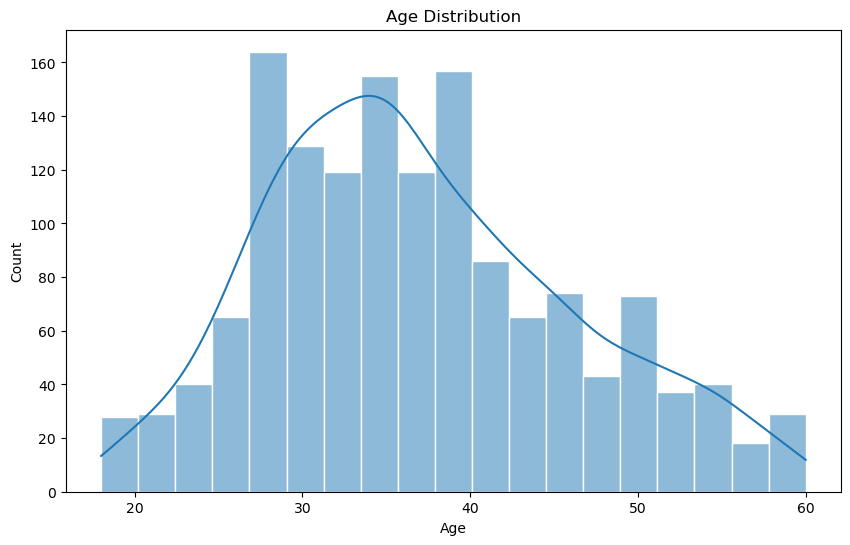

In [13]:
# Age Distribution 
plt.figure(figsize=(10, 6))
sns.histplot(data=df, x='Age',              
             edgecolor='white', 
             alpha=0.5,
             kde=True)
plt.title('Age Distribution')
plt.show()

Gender
Male      882
Female    588
Name: count, dtype: int64


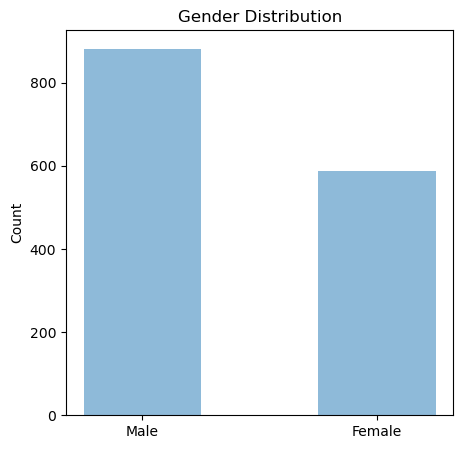

In [14]:
# Calculate the number of female and male employees
gender_counts = df['Gender'].value_counts()
print(gender_counts)

# Plot the data:
plt.figure(figsize=(5,5))
plt.bar(gender_counts.index, gender_counts.values, alpha=0.5, width=0.5)  
plt.ylabel('Count')
plt.title('Gender Distribution')
plt.show()

The above 2 charts give us a quick look at who makes up our workforce in terms of age and gender. 

The histogram shows how old our employees are. Most of our team is between late 20s and 40 years old, with fewer people in their early 20s or over 50. This tells us we have a good mix of experience levels, with a strong core of mid-career professionals. 

The bar chart below shows us the balance between men and women in our company. We have more men than women overall (looks like 6:4 in ratio), but there's still a significant presence of both genders in our workforce. 

These insights help us understand the basic makeup of our team, which is important as we think about our company culture, recruitment strategies, and how we can best support our employees' needs and growth.

In [15]:
# Check some catagorical variables of insterest
print(df['BusinessTravel'].value_counts())
print(df['Department'].value_counts())
print(df['EducationField'].value_counts())
print(df['Gender'].value_counts())
print(df['JobRole'].value_counts())
print(df['MaritalStatus'].value_counts())
print(df['OverTime'].value_counts())


BusinessTravel
Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: count, dtype: int64
Department
Research & Development    961
Sales                     446
Human Resources            63
Name: count, dtype: int64
EducationField
Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: count, dtype: int64
Gender
Male      882
Female    588
Name: count, dtype: int64
JobRole
Sales Executive              326
Research Scientist           292
Laboratory Technician        259
Manufacturing Director       145
Healthcare Representative    131
Manager                      102
Sales Representative          83
Research Director             80
Human Resources               52
Name: count, dtype: int64
MaritalStatus
Married     673
Single      470
Divorced    327
Name: count, dtype: int64
OverTime
No     1054
Yes     416
Name: count, dtype: int64


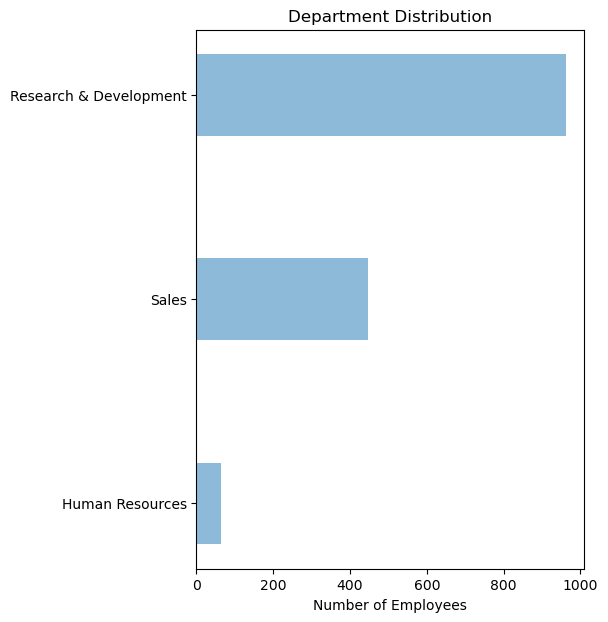

In [16]:
# Sort by number of employees in each department 
department_counts = df['Department'].value_counts().sort_values(ascending=True)
#department_counts

# Plot the data (highest count will be on top)
plt.figure(figsize=(5,7))
plt.barh(department_counts.index, department_counts.values, alpha=0.5, height=0.4)  
plt.xlabel('Number of Employees')
plt.title('Department Distribution')
plt.show()

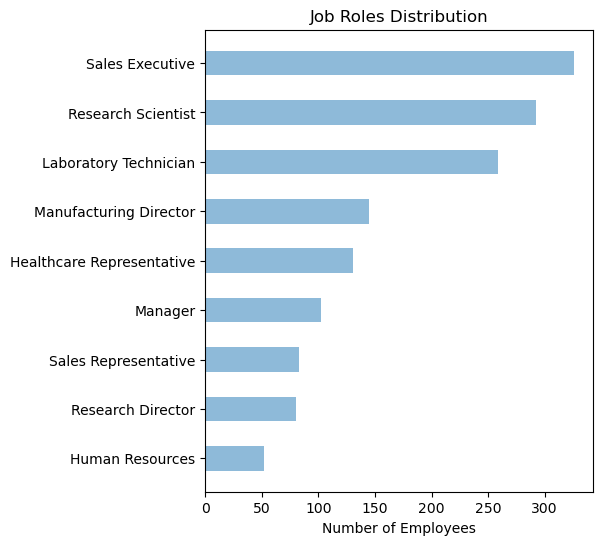

In [17]:
# Sort by number of employees in each job role 
job_roles_counts = df['JobRole'].value_counts().sort_values(ascending=True)
#department_counts

# Plot the data (highest count will be on top)
plt.figure(figsize=(5,6))
plt.barh(job_roles_counts.index, job_roles_counts.values, alpha=0.5, height=0.5)  
plt.xlabel('Number of Employees')
plt.title('Job Roles Distribution')
plt.show()

In [18]:
# Describe all numeric columns of the dataframe
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [19]:
print(df['PerformanceRating'].value_counts())

PerformanceRating
3    1244
4     226
Name: count, dtype: int64


## Check Relationship between Features and Attrition

### A. Find relationship between categorical features and attrition

Text(0.5, 1.0, 'Education Field vs. Attrition')

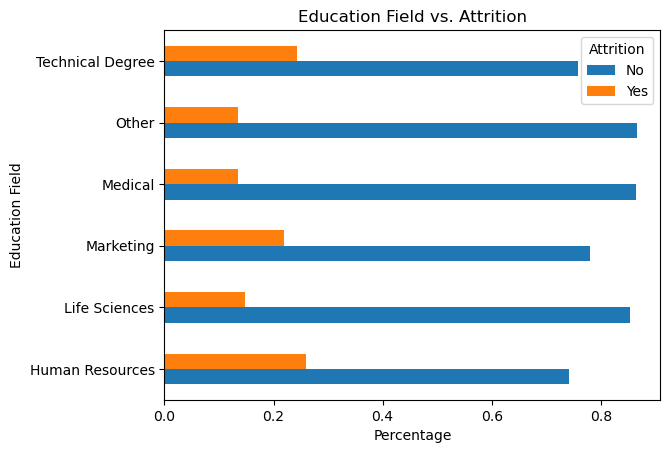

In [20]:
# Check the percentage of employees who left or not (Attrition='Yes') for each categorical feature
df_check = df.groupby(['EducationField'])['Attrition'].value_counts(normalize=True).unstack().reset_index()
#df_check
ax = df_check.plot.barh(x='EducationField', y=['No', 'Yes'])
ax.set_xlabel('Percentage')
ax.set_ylabel('Education Field')
ax.set_title('Education Field vs. Attrition')

In [21]:
def split_words(word):
    '''
    Function to split the PascalCase word into individual words, separated with a space in between
    '''
    return ''.join([' ' + char if char.isupper() else char for char in word]).strip()

In [22]:
def bar_charts_pct(feature, data=df):
    '''
    Inputs:
    feature: Name of Feature to Check against the target variable
    data: The default dataframe is df
    
    Output:
    A horizontal bar chart showing attrition percentage for categories within each variable 
    '''
    # Group by the feature and normalise the attrition counts (i.e. to get percentage)
    grouped_data = data.groupby([feature])['Attrition'].value_counts(normalize=True).unstack().reset_index()

    # Convert to percentage and round to one decimal place
    grouped_data['Yes'] = (grouped_data['Yes'] * 100).round(1)

    # Sort by attrition rate (highest percentage of 'Yes' will be on top)
    sorted_data = grouped_data.sort_values(by='Yes', ascending=True)

    # Plot the data
    ax = sorted_data.plot.barh(x=feature, y='Yes', color='skyblue', legend=False)
    ax.set_xlabel('Attrition Percentage (%)')
    ax.set_ylabel(split_words(feature))
    ax.set_title(f'Attrition Rate for {split_words(feature)}')

    plt.tight_layout()
    plt.show()

In [23]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

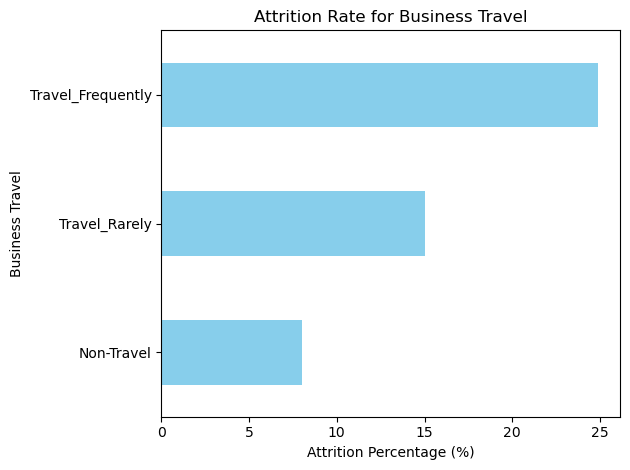

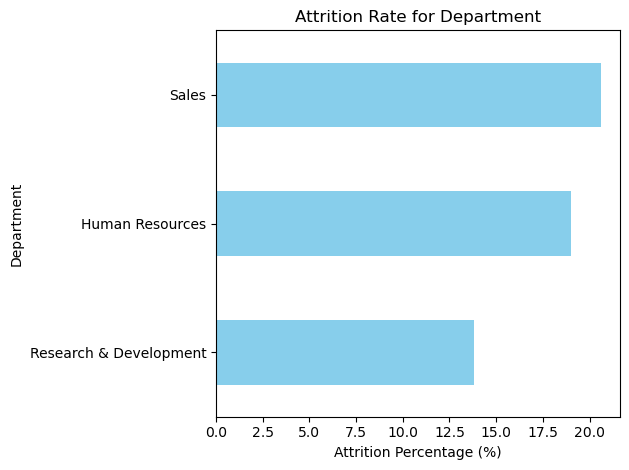

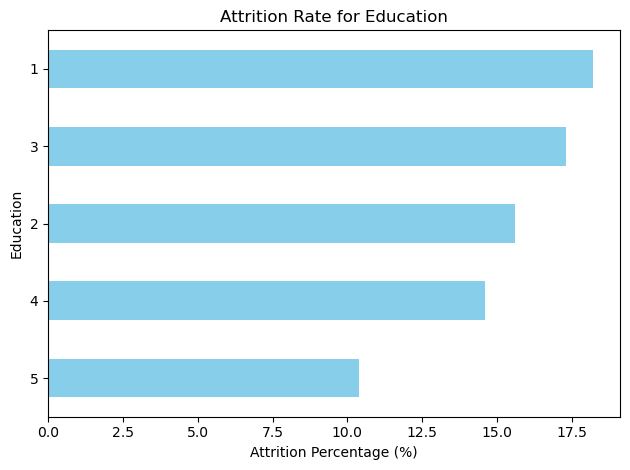

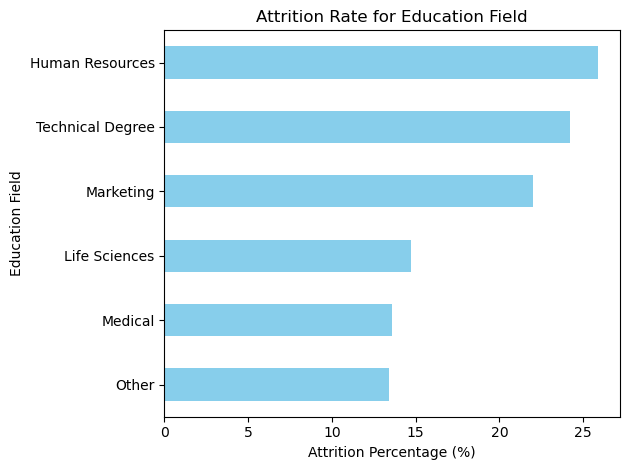

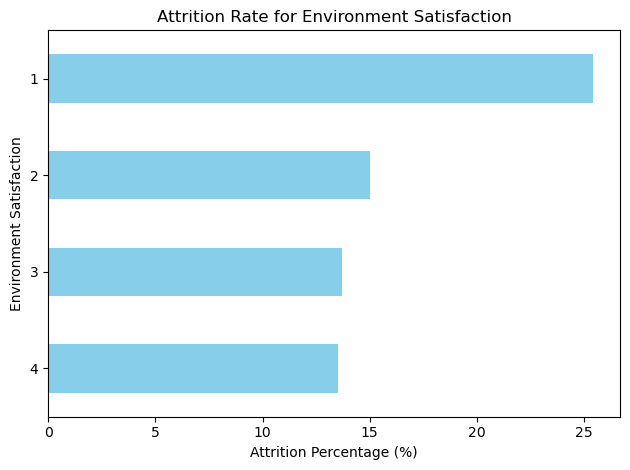

...

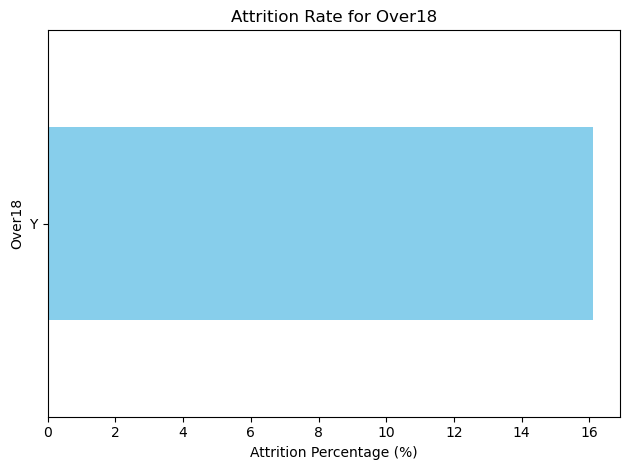

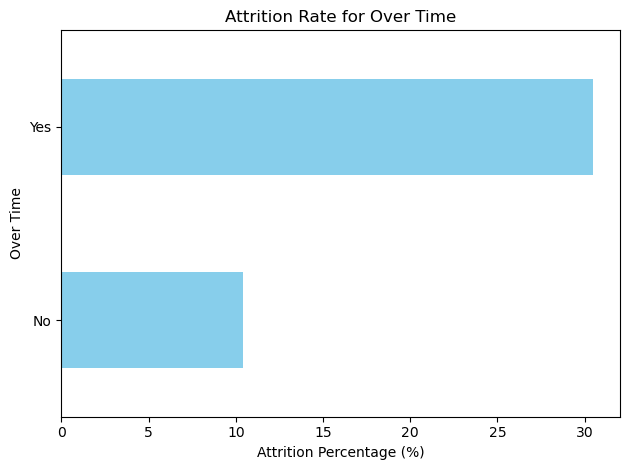

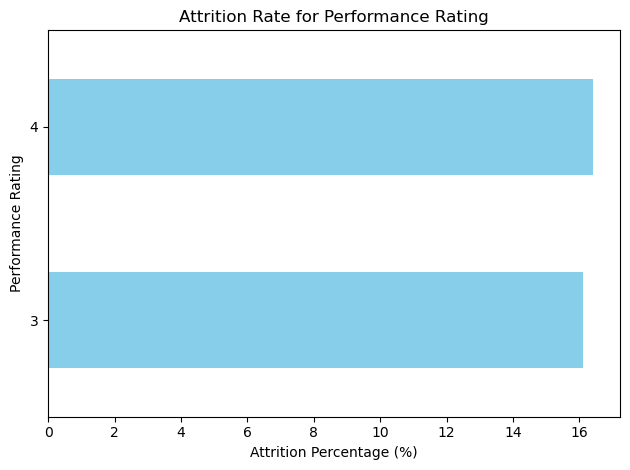

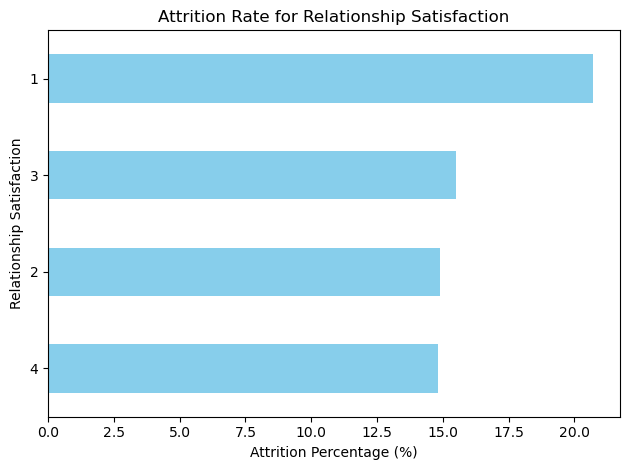

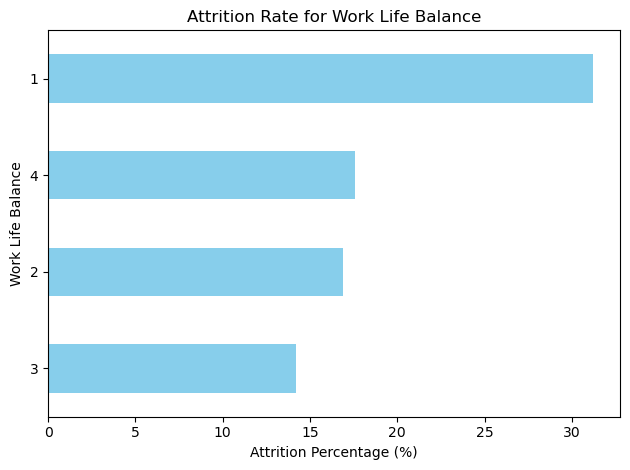

In [24]:
# Create a list of all catgorical columns - according to the original dataset description rather than the data types:
cat_columns = ['BusinessTravel', 'Department',
       'Education', 'EducationField', 'EnvironmentSatisfaction', 'Gender', 
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'Over18', 'OverTime',  'PerformanceRating',
       'RelationshipSatisfaction', 'WorkLifeBalance']

for column in cat_columns:
    #print(column)
    bar_charts_pct(column)

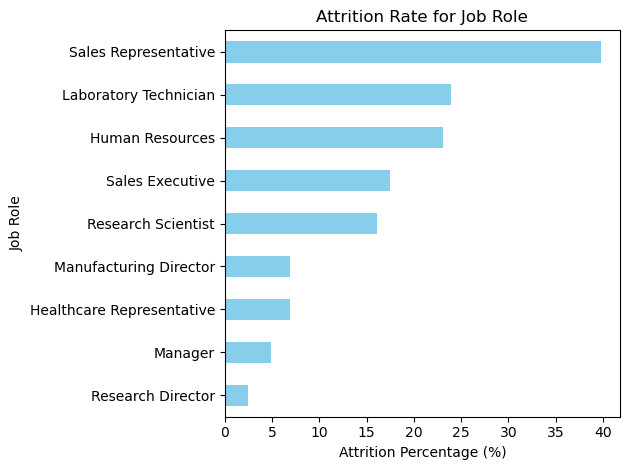

In [25]:
bar_charts_pct('JobRole')

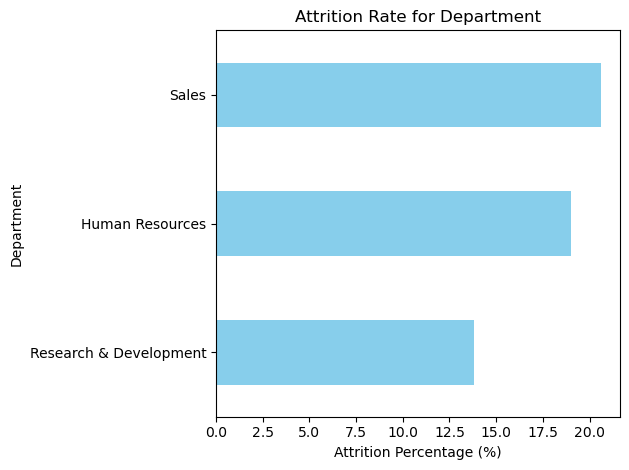

In [26]:
bar_charts_pct('Department')

*Sales-related roles (both department and specific job roles) seem to have the highest attrition rates.

*While Sales has the highest attrition rate, Laboratory Technicians represent a larger portion of the workforce. Their 20-25% attrition rate, applied to a larger employee base, could result in a higher absolute number of departures. This creates a substantial operational challenge.

*Leadership positions like Managers and Directors tend to have lower attrition rates

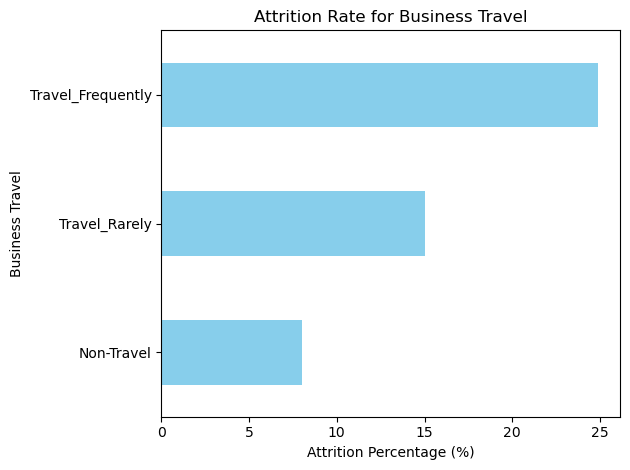

In [27]:
bar_charts_pct('BusinessTravel')

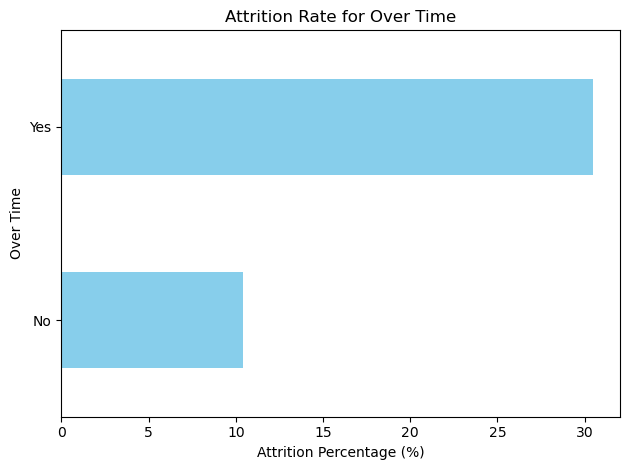

In [28]:
bar_charts_pct('OverTime')

Two factors related to employee attrition:

Business Travel: Frequent travelers have the highest attrition rate at 25%, while non-travelers have the lowest at under 10%.

Overtime: Employees working overtime show a 30% attrition rate, double that of those who don't work extra hours.

These findings suggest that managing travel demands and work hours could be key to improving employee retention.


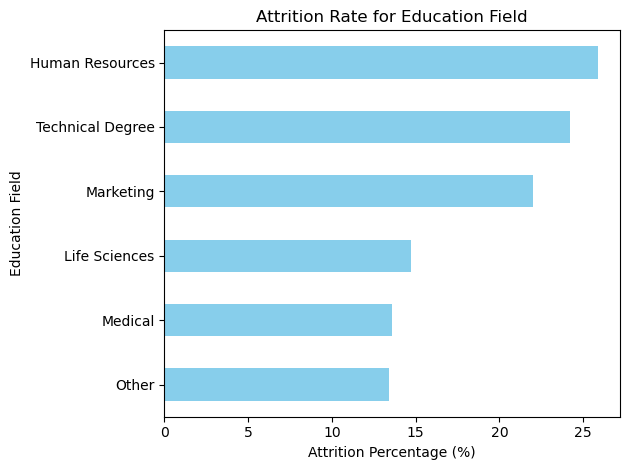

In [29]:
bar_charts_pct('EducationField')

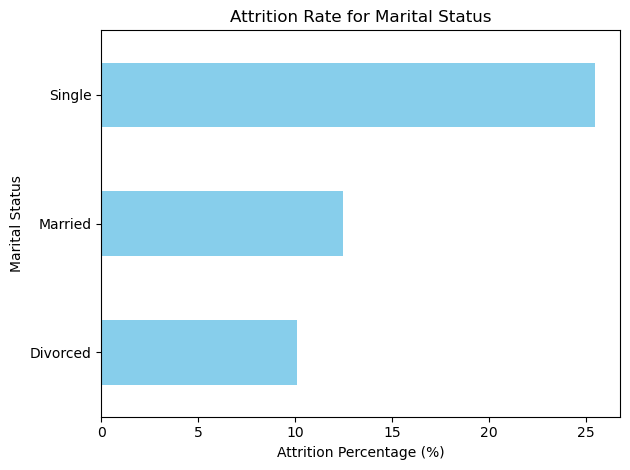

In [30]:
bar_charts_pct('MaritalStatus')

For Marital Status and Education Fields:

Single employees have highest attrition (25%), married lower (15%), divorced lowest (10%)


HR field shows unexpectedly high attrition;  

Technical and Marketing degrees associated with higher attrition;  

Life Sciences and Medical fields retain employees better.

### B. Find relationship between numerical features and attrition

In [31]:
df_copy = df.copy(deep=True)

# Change binary columns (yes/no) to numbers
df_copy.replace({'No': 0, 'Yes':1}, inplace=True) 

# Create a dataframe with numerical columns only
df_num = df_copy.select_dtypes(exclude='object')

df_num.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 28 columns):
 #   Column                    Non-Null Count  Dtype
---  ------                    --------------  -----
 0   Age                       1470 non-null   int64
 1   Attrition                 1470 non-null   int64
 2   DailyRate                 1470 non-null   int64
 3   DistanceFromHome          1470 non-null   int64
 4   Education                 1470 non-null   int64
 5   EmployeeCount             1470 non-null   int64
 6   EmployeeNumber            1470 non-null   int64
 7   EnvironmentSatisfaction   1470 non-null   int64
 8   HourlyRate                1470 non-null   int64
 9   JobInvolvement            1470 non-null   int64
 10  JobLevel                  1470 non-null   int64
 11  JobSatisfaction           1470 non-null   int64
 12  MonthlyIncome             1470 non-null   int64
 13  MonthlyRate               1470 non-null   int64
 14  NumCompaniesWorked        1470 non-null 

In [32]:
df_num.describe()

,Age,Attrition,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,0.161224,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,0.367863,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,0.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,0.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,0.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,0.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [33]:
# Dropping the columns 
df_num.drop(['EmployeeCount', 'StandardHours', 'OverTime'], axis=1, inplace=True) 

In [34]:
df_num.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 25 columns):
 #   Column                    Non-Null Count  Dtype
---  ------                    --------------  -----
 0   Age                       1470 non-null   int64
 1   Attrition                 1470 non-null   int64
 2   DailyRate                 1470 non-null   int64
 3   DistanceFromHome          1470 non-null   int64
 4   Education                 1470 non-null   int64
 5   EmployeeNumber            1470 non-null   int64
 6   EnvironmentSatisfaction   1470 non-null   int64
 7   HourlyRate                1470 non-null   int64
 8   JobInvolvement            1470 non-null   int64
 9   JobLevel                  1470 non-null   int64
 10  JobSatisfaction           1470 non-null   int64
 11  MonthlyIncome             1470 non-null   int64
 12  MonthlyRate               1470 non-null   int64
 13  NumCompaniesWorked        1470 non-null   int64
 14  PercentSalaryHike         1470 non-null 

### Try different plots to view the correlation

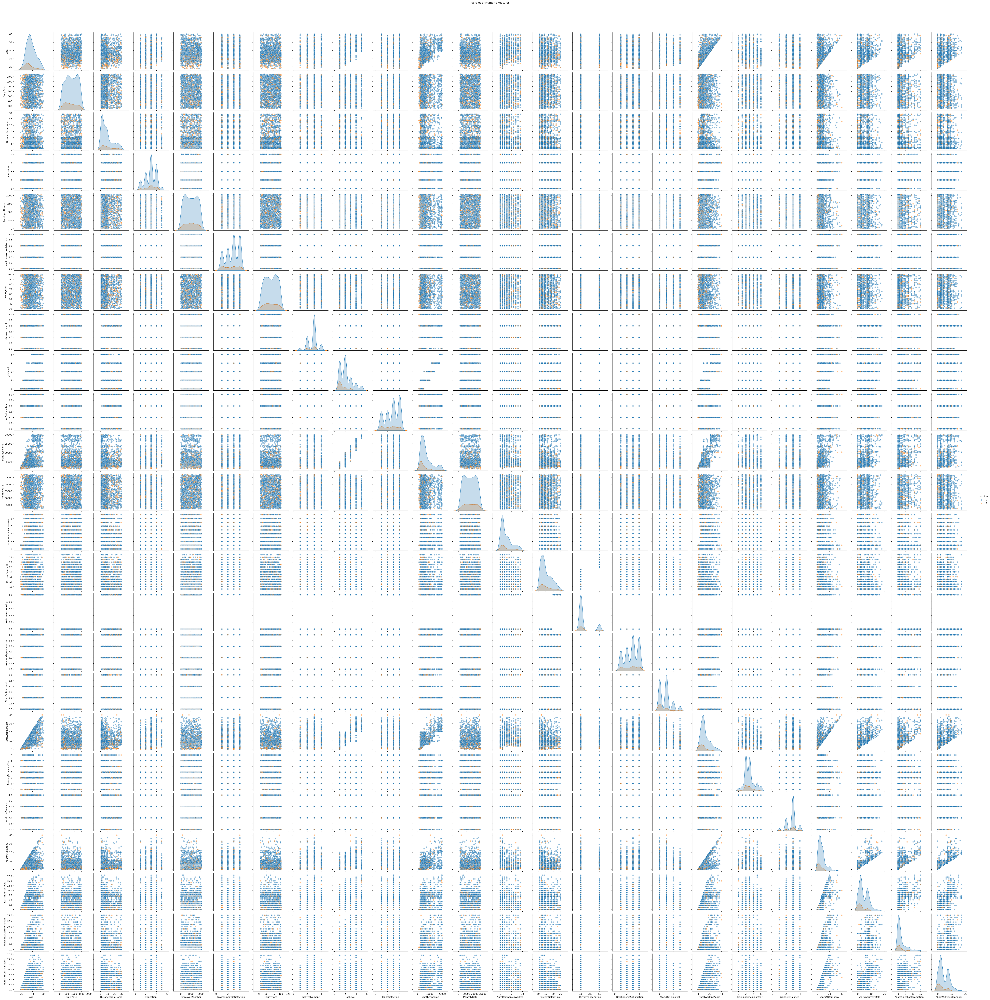

In [35]:
# Create pairplot
sns.pairplot(df_num, hue='Attrition', plot_kws={'alpha':0.5})
plt.suptitle('Pairplot of Numeric Features', y=1.02)
plt.show()

In [36]:
# Check correlation matrix:
corr = df_num.corr()
corr.style.background_gradient(cmap='coolwarm')

,Age,Attrition,DailyRate,DistanceFromHome,Education,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,-0.159205,0.010661,-0.001686,0.208034,-0.010145,0.010146,0.024287,0.029820,0.509604,-0.004892,0.497855,0.028051,0.299635,0.003634,0.001904,0.053535,0.037510,0.680381,-0.019621,-0.021490,0.311309,0.212901,0.216513,0.202089
Attrition,-0.159205,1.000000,-0.056652,0.077924,-0.031373,-0.010577,-0.103369,-0.006846,-0.130016,-0.169105,-0.103481,-0.159840,0.015170,0.043494,-0.013478,0.002889,-0.045872,-0.137145,-0.171063,-0.059478,-0.063939,-0.134392,-0.160545,-0.033019,-0.156199
DailyRate,0.010661,-0.056652,1.000000,-0.004985,-0.016806,-0.050990,0.018355,0.023381,0.046135,0.002966,0.030571,0.007707,-0.032182,0.038153,0.022704,0.000473,0.007846,0.042143,0.014515,0.002453,-0.037848,-0.034055,0.009932,-0.033229,-0.026363
DistanceFromHome,-0.001686,0.077924,-0.004985,1.000000,0.021042,0.032916,-0.016075,0.031131,0.008783,0.005303,-0.003669,-0.017014,0.027473,-0.029251,0.040235,0.027110,0.006557,0.044872,0.004628,-0.036942,-0.026556,0.009508,0.018845,0.010029,0.014406
Education,0.208034,-0.031373,-0.016806,0.021042,1.000000,0.042070,-0.027128,0.016775,0.042438,0.101589,-0.011296,0.094961,-0.026084,0.126317,-0.011111,-0.024539,-0.009118,0.018422,0.148280,-0.025100,0.009819,0.069114,0.060236,0.054254,0.069065
EmployeeNumber,-0.010145,-0.010577,-0.050990,0.032916,0.042070,1.000000,0.017621,0.035179,-0.006888,-0.018519,-0.046247,-0.014829,0.012648,-0.001251,-0.012944,-0.020359,-0.069861,0.062227,-0.014365,0.023603,0.010309,-0.011240,-0.008416,-0.009019,-0.009197
EnvironmentSatisfaction,0.010146,-0.103369,0.018355,-0.016075,-0.027128,0.017621,1.000000,-0.049857,-0.008278,0.001212,-0.006784,-0.006259,0.037600,0.012594,-0.031701,-0.029548,0.007665,0.003432,-0.002693,-0.019359,0.027627,0.001458,0.018007,0.016194,-0.004999
HourlyRate,0.024287,-0.006846,0.023381,0.031131,0.016775,0.035179,-0.049857,1.000000,0.042861,-0.027853,-0.071335,-0.015794,-0.015297,0.022157,-0.009062,-0.002172,0.001330,0.050263,-0.002334,-0.008548,-0.004607,-0.019582,-0.024106,-0.026716,-0.020123
JobInvolvement,0.029820,-0.130016,0.046135,0.008783,0.042438,-0.006888,-0.008278,0.042861,1.000000,-0.012630,-0.021476,-0.015271,-0.016322,0.015012,-0.017205,-0.029071,0.034297,0.021523,-0.005533,-0.015338,-0.014617,-0.021355,0.008717,-0.024184,0.025976
JobLevel,0.509604,-0.169105,0.002966,0.005303,0.101589,-0.018519,0.001212,-0.027853,-0.012630,1.000000,-0.001944,0.950300,0.039563,0.142501,-0.034730,-0.021222,0.021642,0.013984,0.782208,-0.018191,0.037818,0.534739,0.389447,0.353885,0.375281


Text(0.5, 1.05, 'Correlation of Numeric Features')

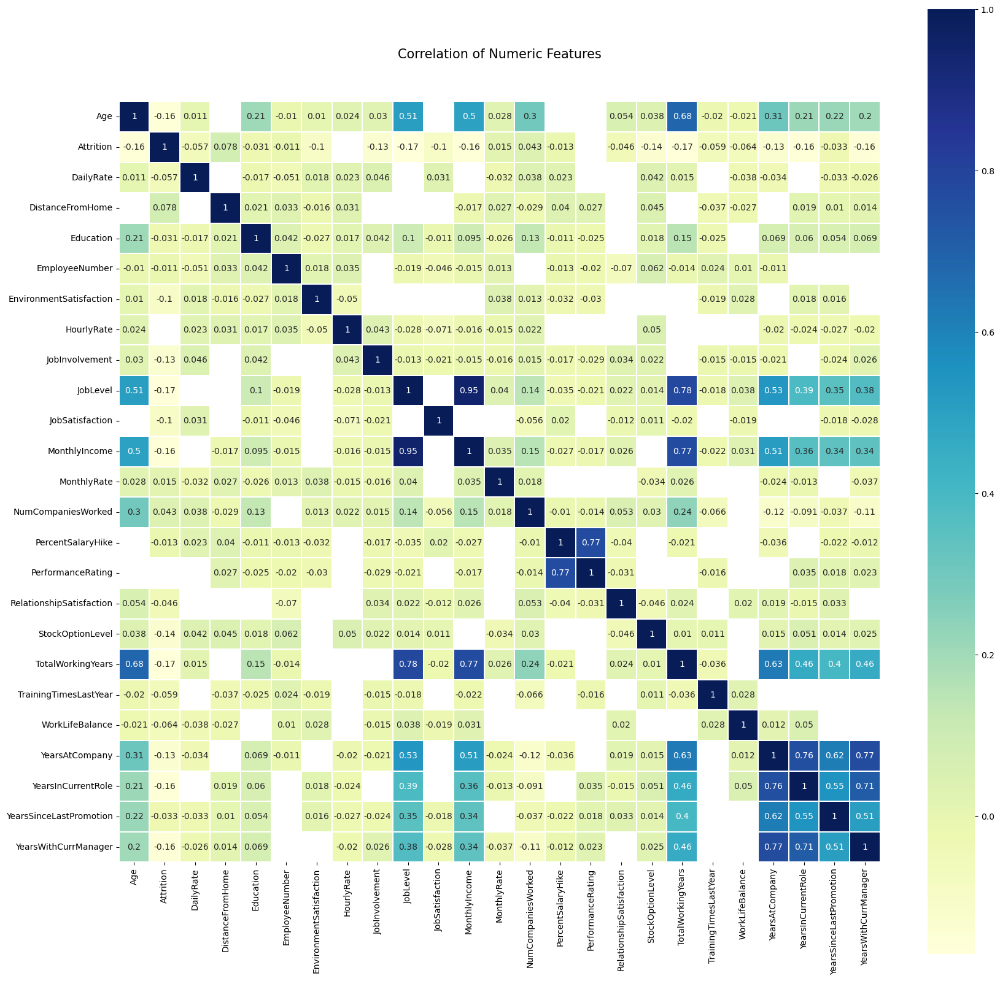

In [37]:
# Create a mask for values that pass a threshold absolute correlation 
mask = np.abs(corr) <= 0.01

# Plot the heatmap and only the correlations with an absolute value greater than the above mask threshold will be coloured  
f, ax= plt.subplots(figsize=(20,20))
cmap = sns.diverging_palette(220, 10, as_cmap= True)
_= sns.heatmap(corr, cmap= 'YlGnBu', square=True, ax=ax, annot=True, linewidth=0.1, mask=mask)
plt.title('Correlation of Numeric Features', y=1.05, size=15)

In [38]:
corr['Attrition']

Age                        -0.159205
Attrition                   1.000000
DailyRate                  -0.056652
DistanceFromHome            0.077924
Education                  -0.031373
EmployeeNumber             -0.010577
EnvironmentSatisfaction    -0.103369
HourlyRate                 -0.006846
JobInvolvement             -0.130016
JobLevel                   -0.169105
JobSatisfaction            -0.103481
MonthlyIncome              -0.159840
MonthlyRate                 0.015170
NumCompaniesWorked          0.043494
PercentSalaryHike          -0.013478
PerformanceRating           0.002889
RelationshipSatisfaction   -0.045872
StockOptionLevel           -0.137145
TotalWorkingYears          -0.171063
TrainingTimesLastYear      -0.059478
WorkLifeBalance            -0.063939
YearsAtCompany             -0.134392
YearsInCurrentRole         -0.160545
YearsSinceLastPromotion    -0.033019
YearsWithCurrManager       -0.156199
Name: Attrition, dtype: float64

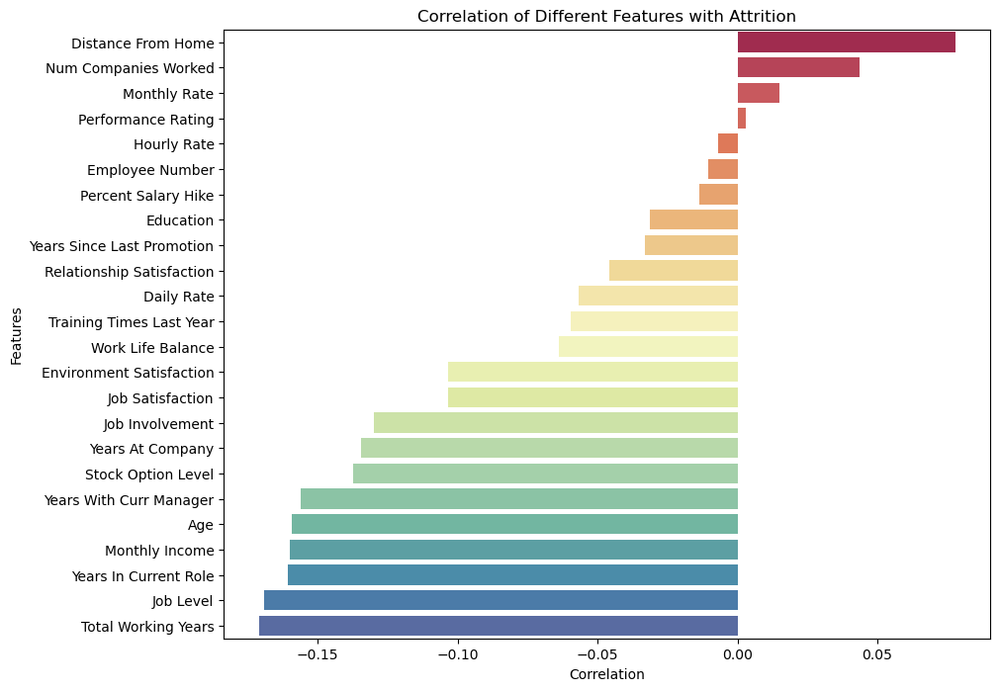

In [39]:
# Calculate correlations with Attrition only:
corr_attrition = corr['Attrition'].sort_values(ascending=False)

# Filter to exclude the Attrition row
corr_attrition = corr_attrition.drop('Attrition')

# Create a list of custom labels using split_words
feature_labels = [split_words(feature) for feature in corr_attrition.index.to_numpy()]

# Plotting
plt.figure(figsize=(10, 8))
ax = sns.barplot(x=corr_attrition.values, y=feature_labels, 
                 hue=corr_attrition.index,
                 palette='Spectral',
                 legend=False
                )

# Adding labels and title
plt.xlabel('Correlation')
plt.ylabel('Features')
plt.title('Correlation of Different Features with Attrition')

plt.show()

*Correlation measures* how strongly two variables or features are related, ranging from -1 to 1. A positive correlation means as one variable increases, so does the attrition, while a negative correlation means they move in opposite directions.

The chart reveals that distance from home and number of companies worked have the strongest positive correlations with attrition. This means employees living farther from work or with more varied job histories are more likely to leave. 

On the flip side, total working years, job level, and years in current role have the strongest negative correlations, indicating that more experienced employees and those in higher positions tend to stay longer.


### Plot the distribution of numerical features vs Attrition:

#### Try 1 feature first then create functions to go through all numeric features to find meaningful ones


In [40]:
df_num.columns

Index(['Age', 'Attrition', 'DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
       'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

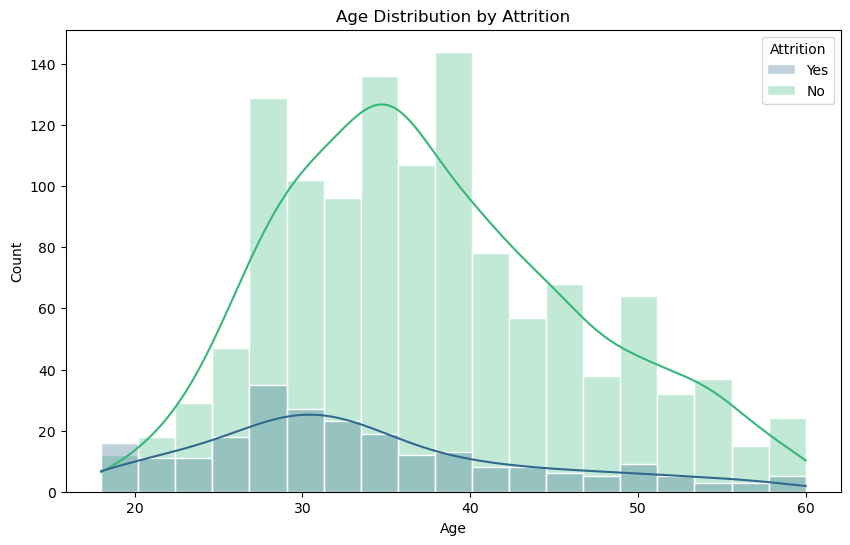

In [41]:
# Age Distribution by Attrition
plt.figure(figsize=(10, 6))
sns.histplot(data=df, x='Age', 
             hue='Attrition', 
             palette='viridis', 
             edgecolor='white', 
             alpha=0.3,
             kde=True)
plt.title('Age Distribution by Attrition')
plt.show()

In [42]:
def plot_histogram(feature, data=df, target='Attrition'):
    plt.figure(figsize=(10, 6))
    sns.histplot(data=data, x=feature, 
                 hue=target, 
                 palette='viridis', 
                 edgecolor='white', 
                 alpha=0.3,
                 kde=True)
    plt.xlabel(split_words(feature))
    plt.title(f'{split_words(feature)} Distribution by {target}')
    plt.show()

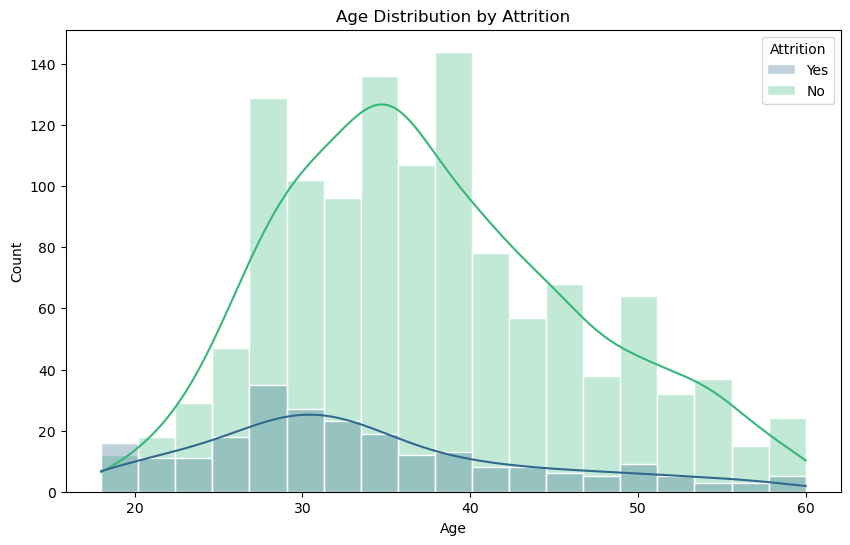

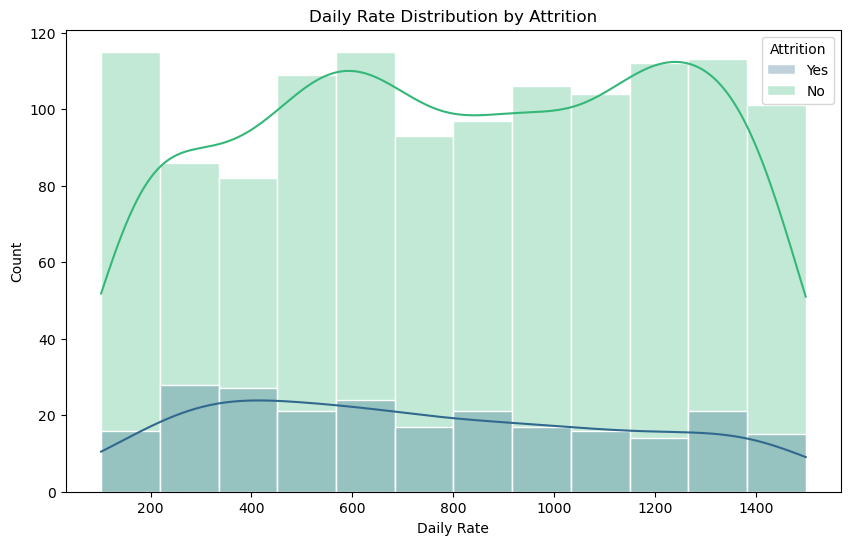

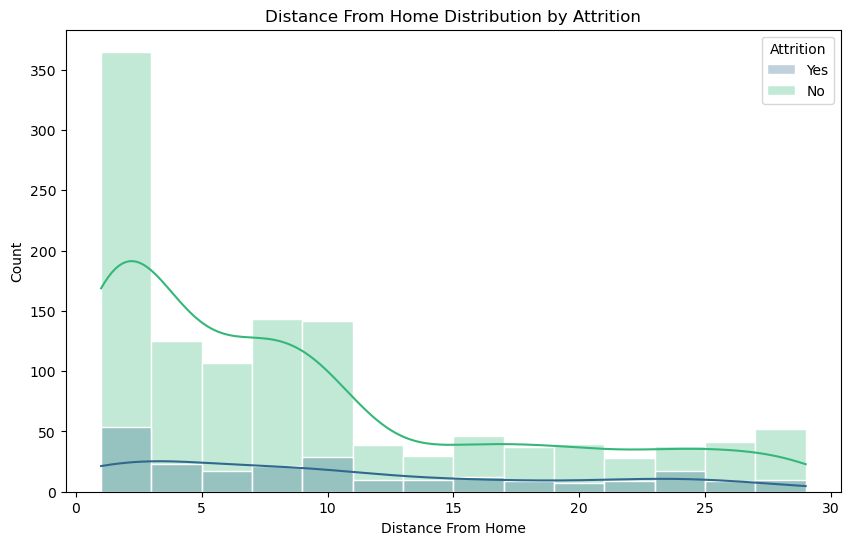

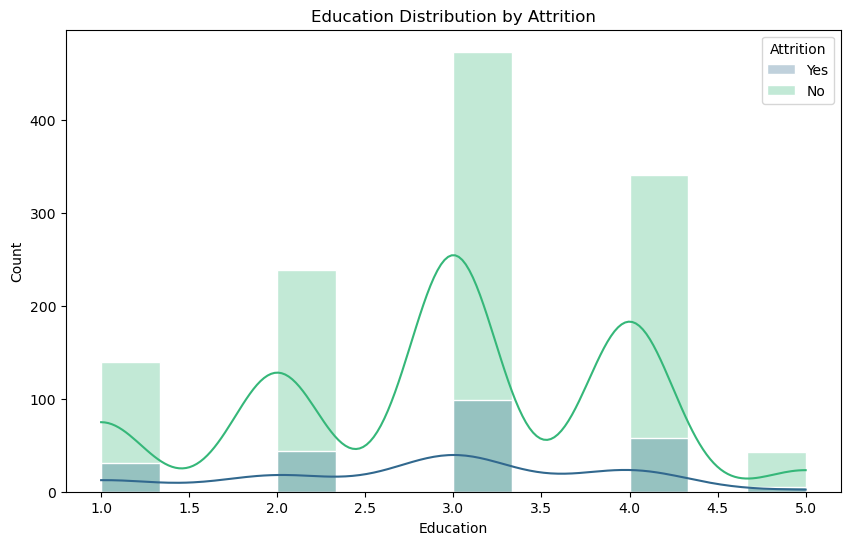

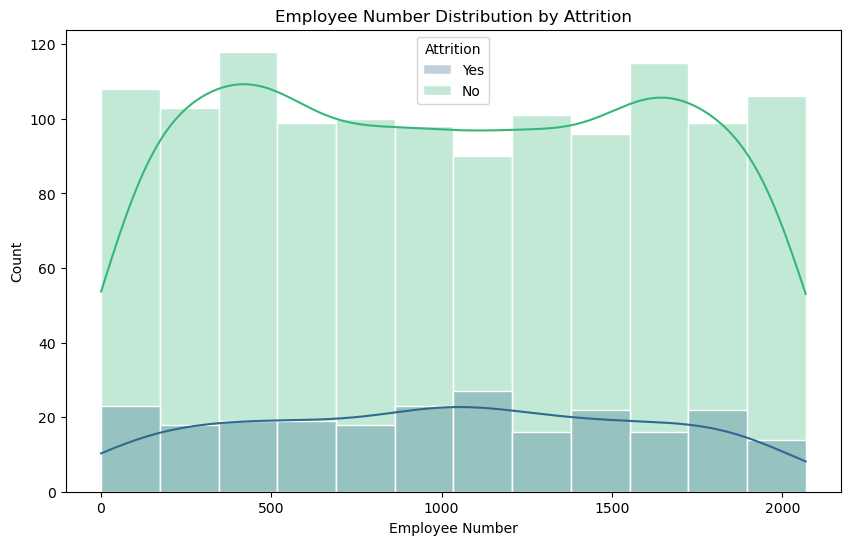

...

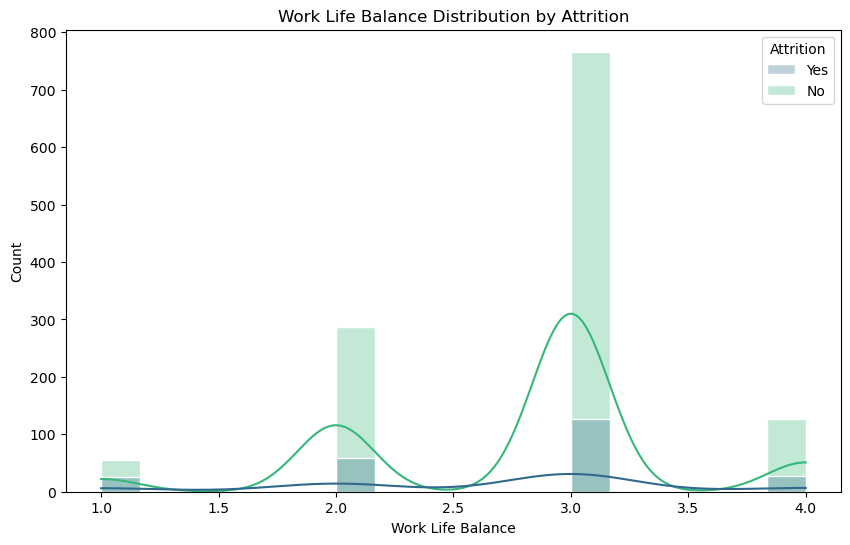

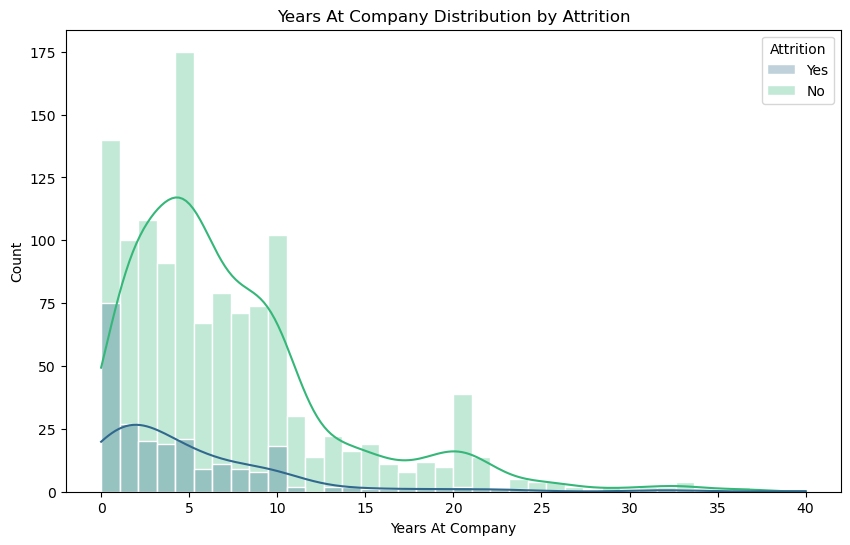

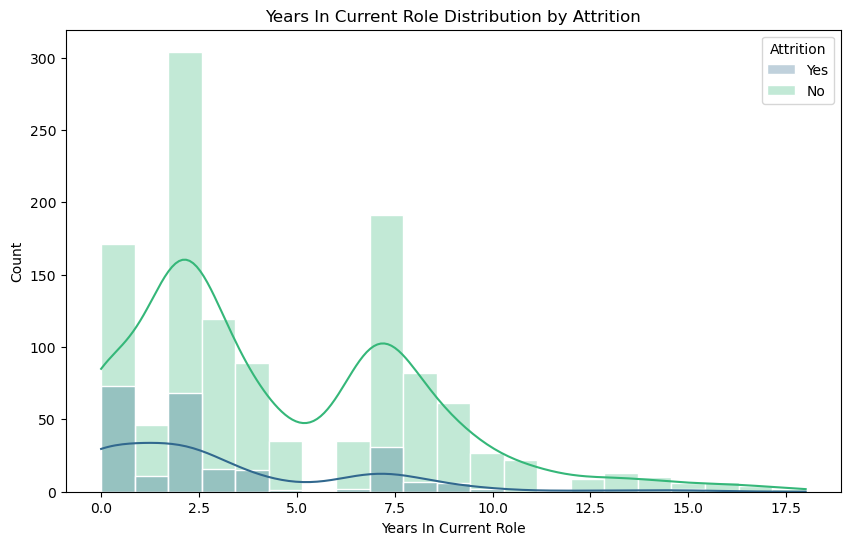

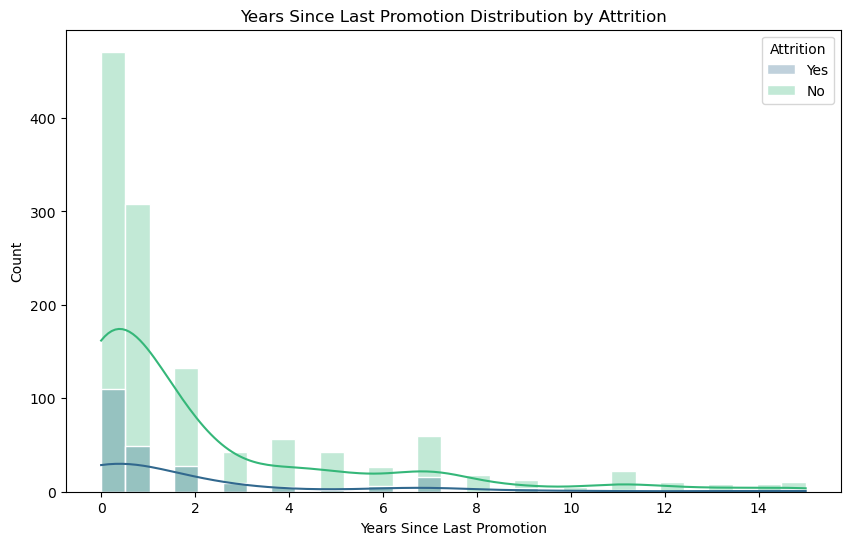

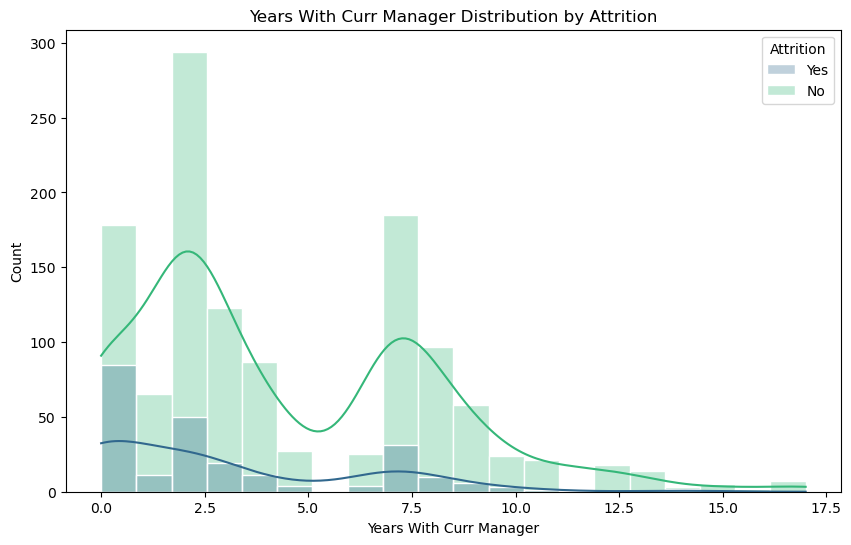

In [43]:
for column in df_num.columns: 
    if column != "Attrition":
        plot_histogram(column)

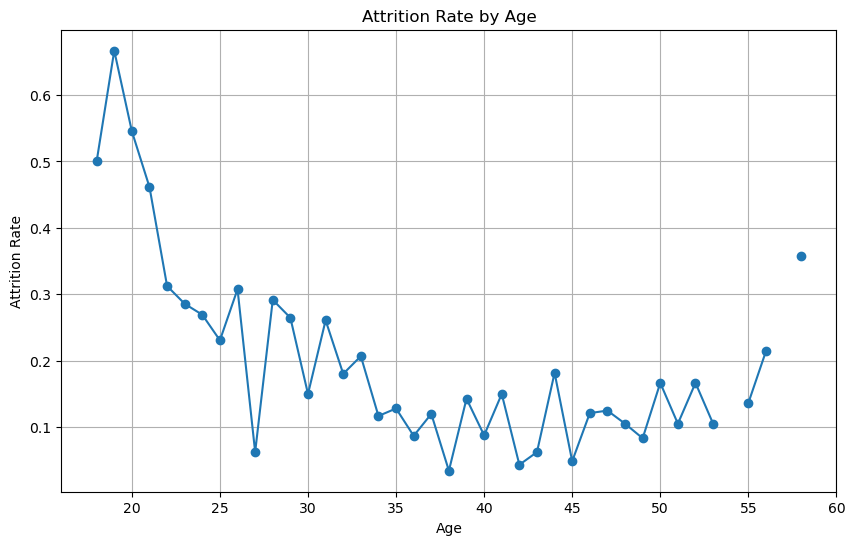

In [44]:
# Calculate the attrition rate by age
attrition_by_age = df.groupby('Age')['Attrition'].value_counts(normalize=True).unstack().reset_index()

# Plot the line chart
plt.figure(figsize=(10, 6))
plt.plot(attrition_by_age['Age'], attrition_by_age['Yes'], marker='o')
plt.xlabel('Age')
plt.ylabel('Attrition Rate')
plt.title('Attrition Rate by Age')
plt.grid(True)
plt.show()

In [45]:
def plot_trendline(feature, data=df, target='Attrition', target_class='Yes'):
    """
      Plots the distribution of a target variable within categories of a feature, along with a trend line.

     Inputs:
      feature (str): The name of the feature variable to be used on the x-axis.
      data (pandas.DataFrame, optional): The input DataFrame containing the data.(default: df)      
      target (str, optional): The name of the target variable to be visualised (default: 'Attrition').
      target_class (str, optional): The specific class within the target variable to plot (default: 'Yes'). 
     Output:
      This function does not return a value, but creates a visualisation.
    """
    # Calculate percentage distribution of target variable by feature category
    pct_by_feature = data.groupby(feature)[target].value_counts(normalize=True).unstack().reset_index()
    
    # Plot the data with the trend line
    plt.figure(figsize=(10, 6))
    sns.regplot(x=feature, y=target_class, data=pct_by_feature)

    plt.xlabel(split_words(feature))
    plt.ylabel(target)
    plt.title(f'{target} (%) by {split_words(feature)}')
    plt.grid(True)
    plt.show()

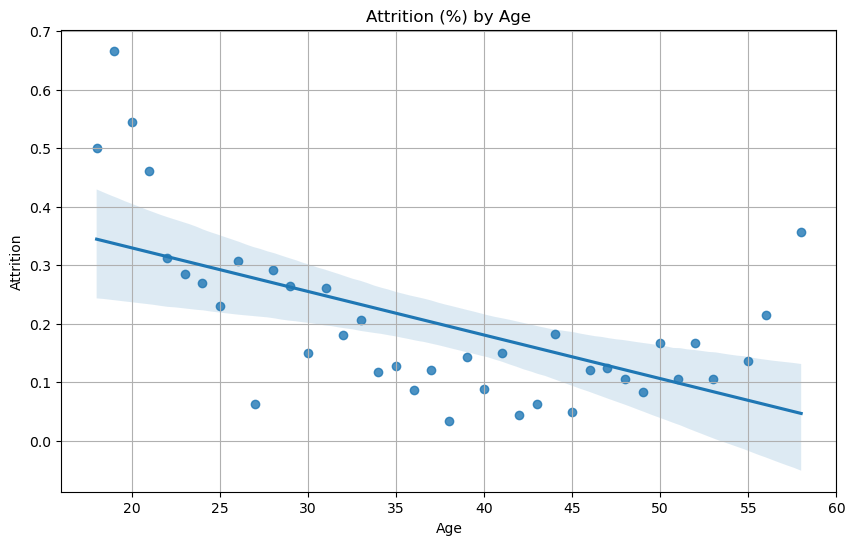

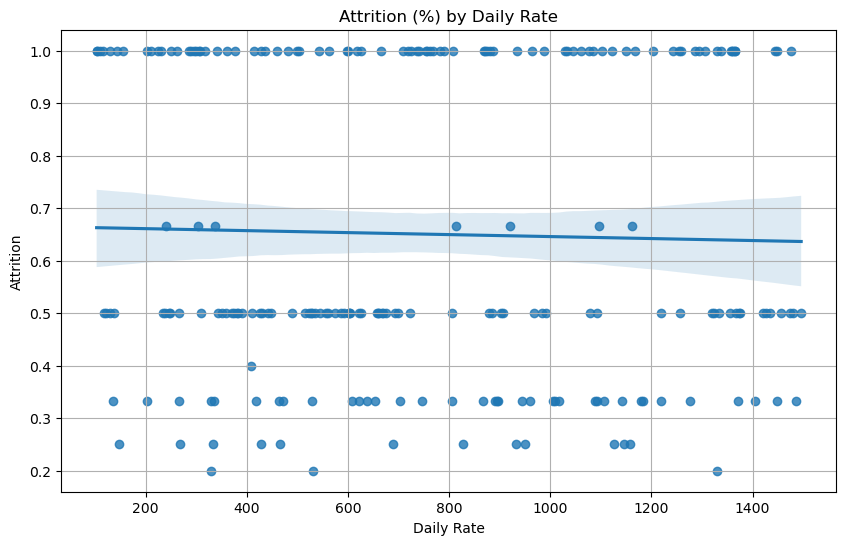

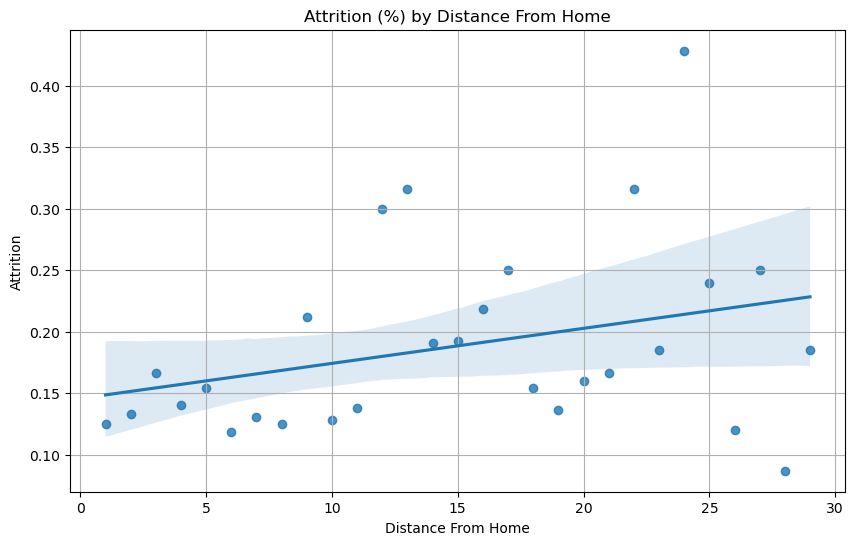

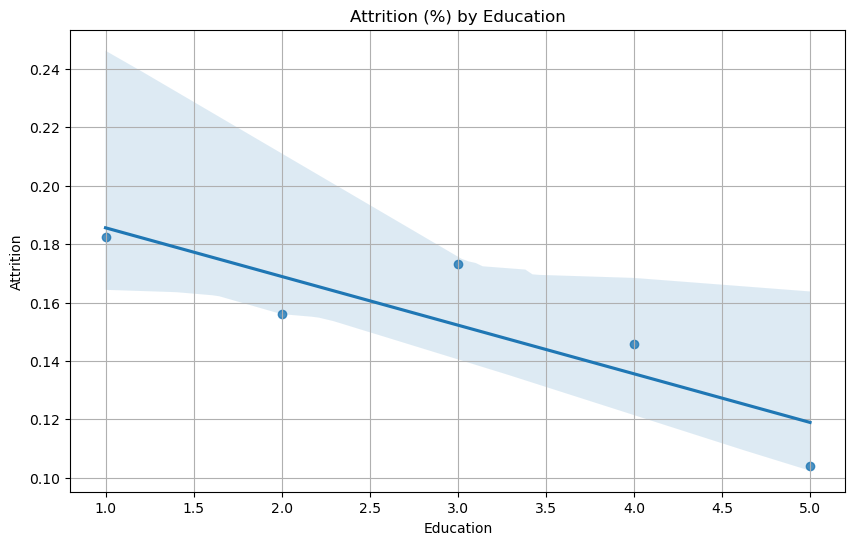

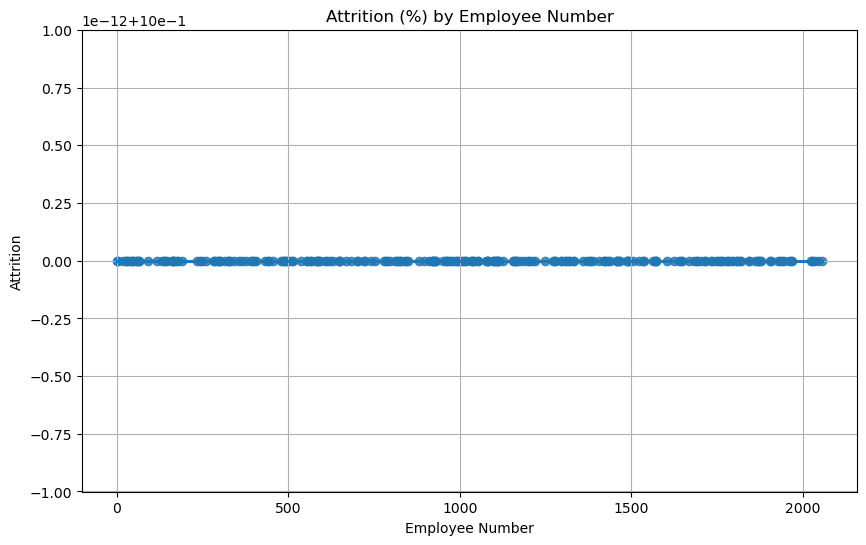

...

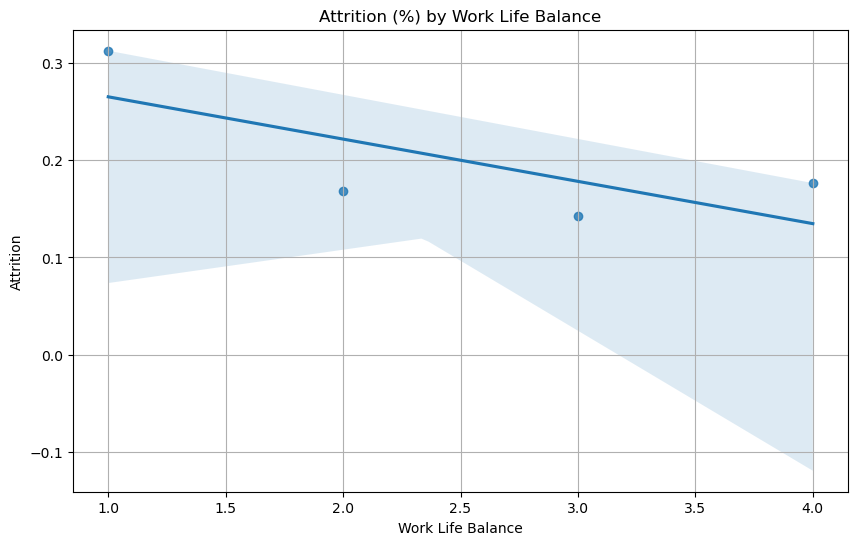

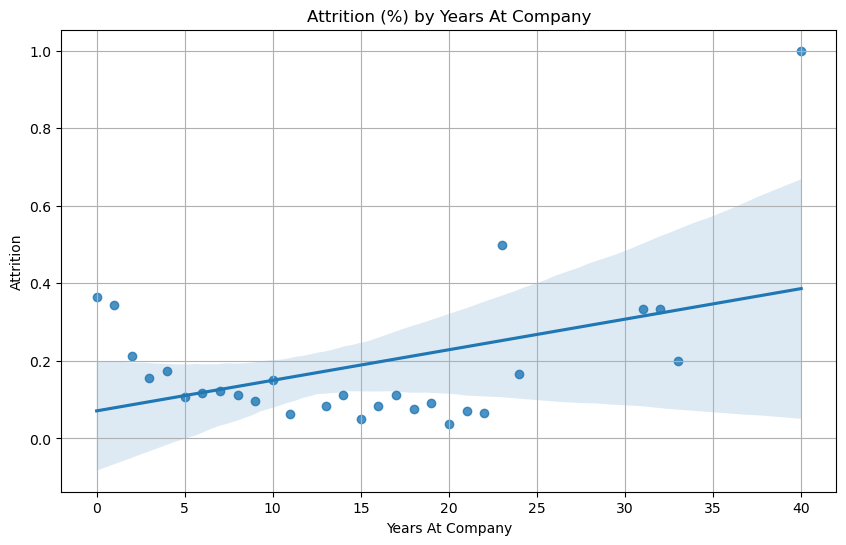

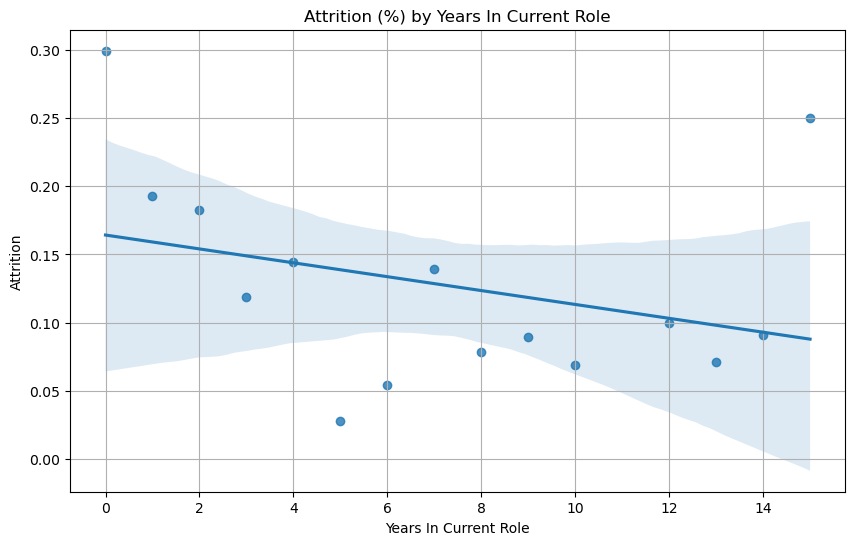

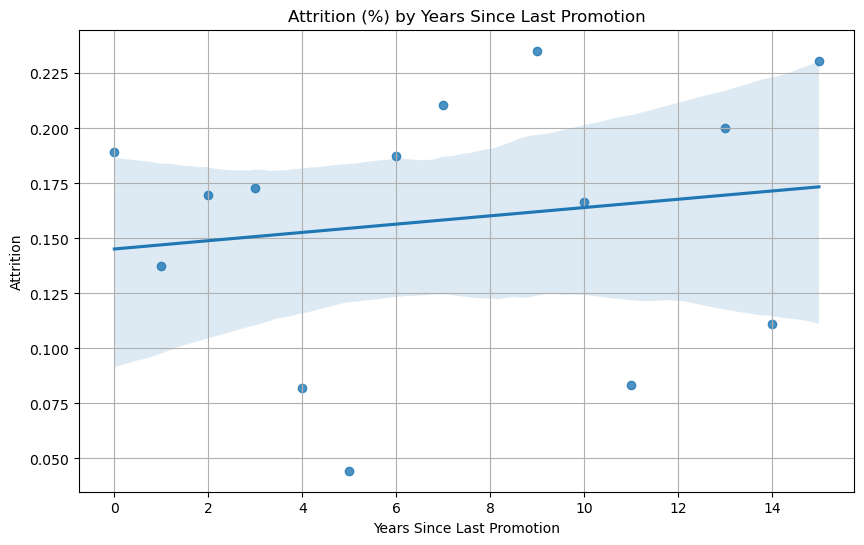

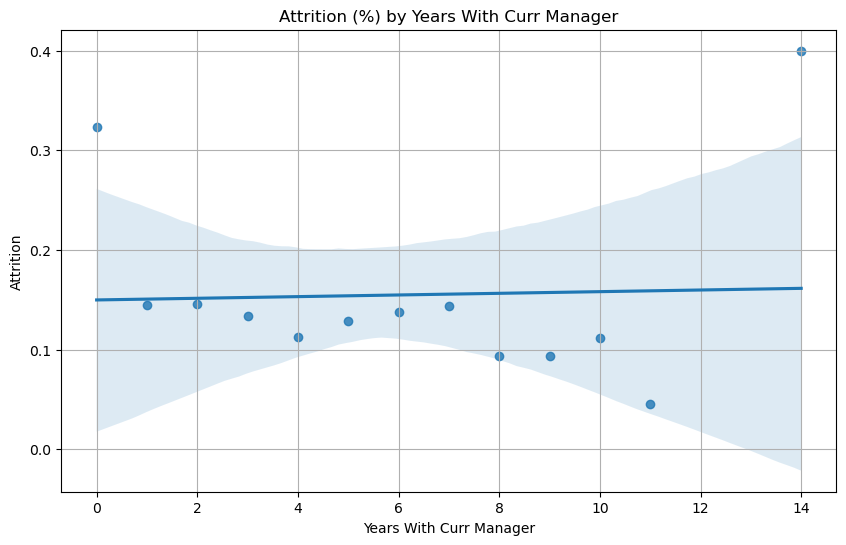

In [46]:
for column in df_num.columns: 
    if column != "Attrition":
        plot_trendline(column)

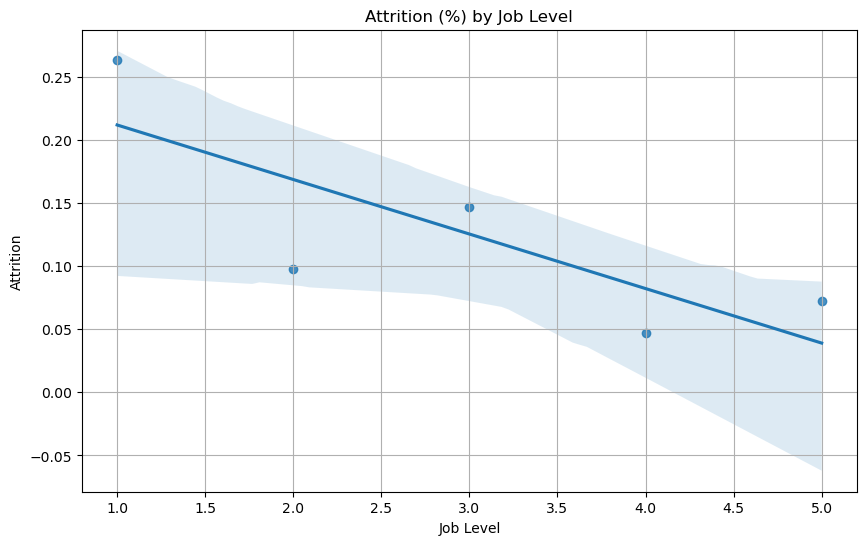

In [47]:
plot_trendline('JobLevel')

In [48]:
def plot_boxplot(feature, data=df):
    '''
    Inputs:
    feature: Name of Feature to Check against the target variable
    data: The default dataset is df

    Output:
    A boxplot showing the distribution of each numeric variable for different attrition group? 
    '''
    sns.boxplot(x=feature, y='Attrition', data=data, 
                hue='Attrition',
                palette='coolwarm', 
                showmeans=True, 
                width=0.5).set(
                xlabel=split_words(feature),
                ylabel='Attrition',
                title=f'Distribution of {split_words(feature)} by Attrition')

    plt.tight_layout()
    plt.show()


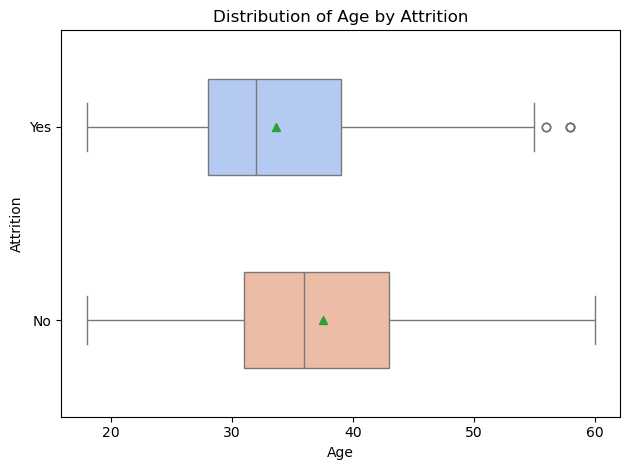

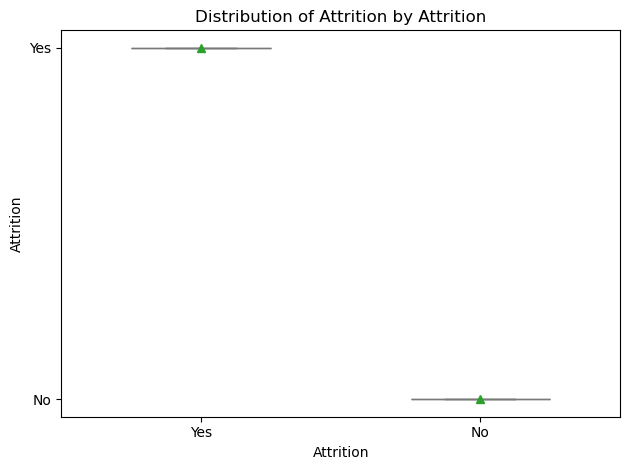

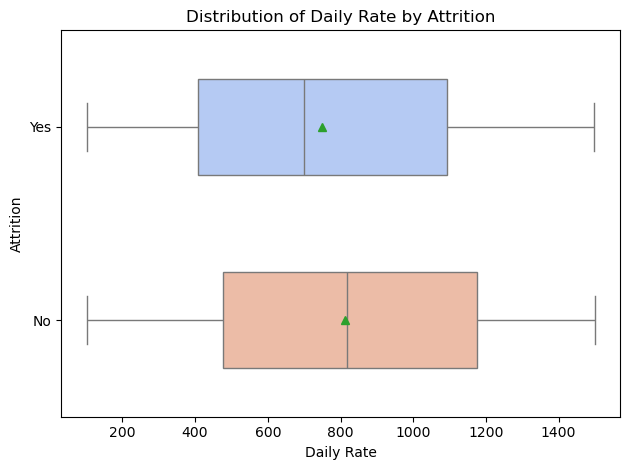

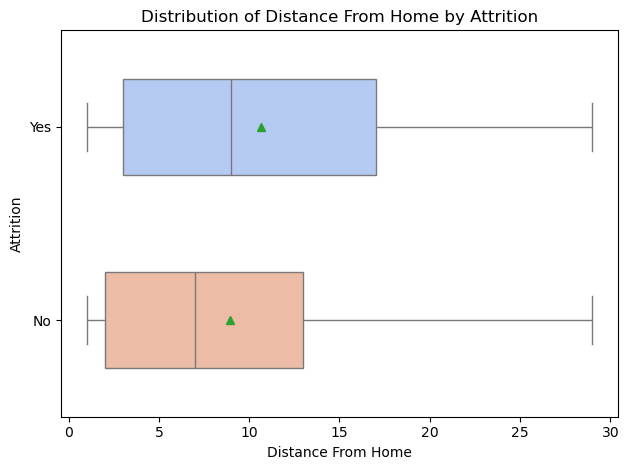

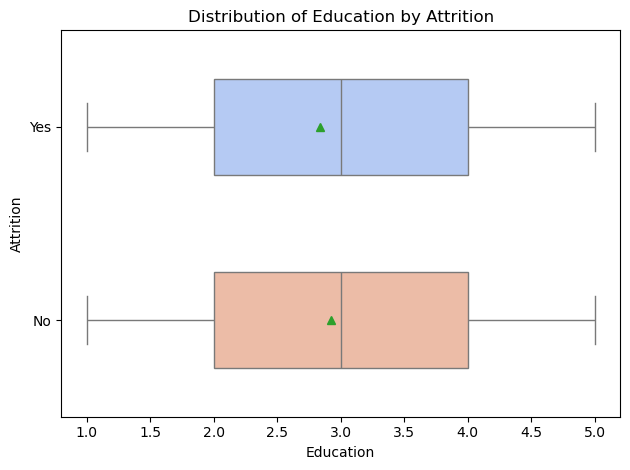

...

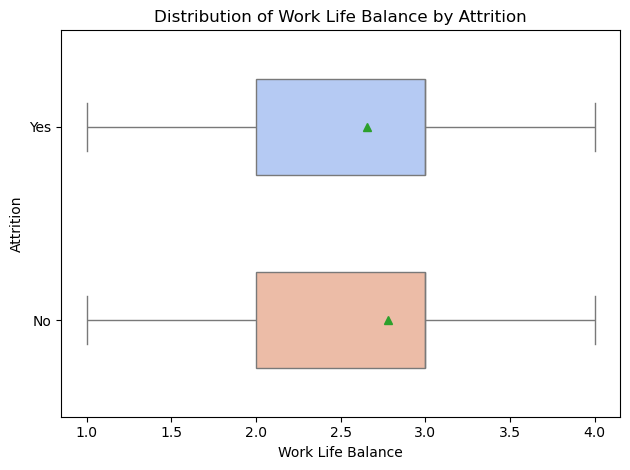

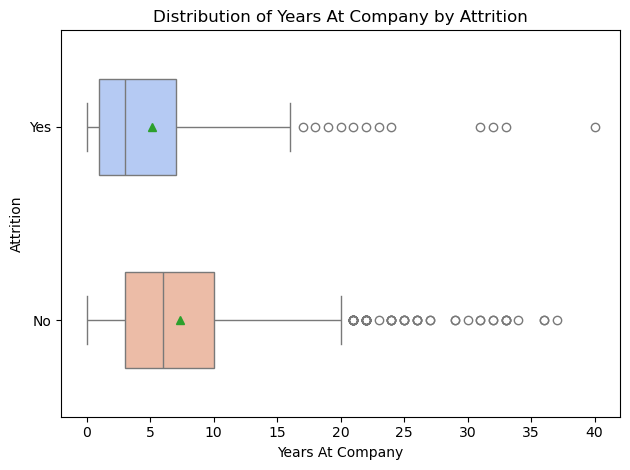

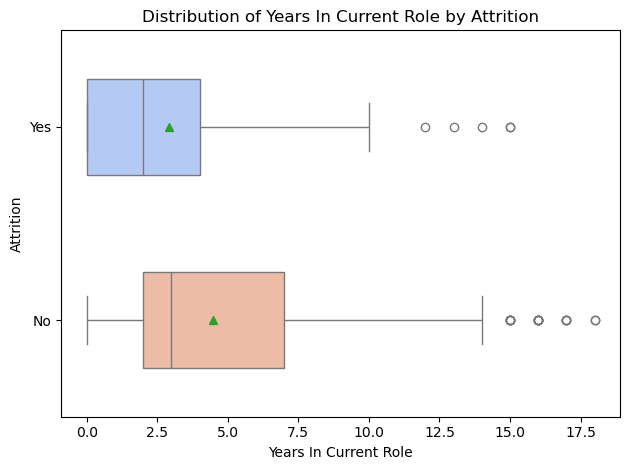

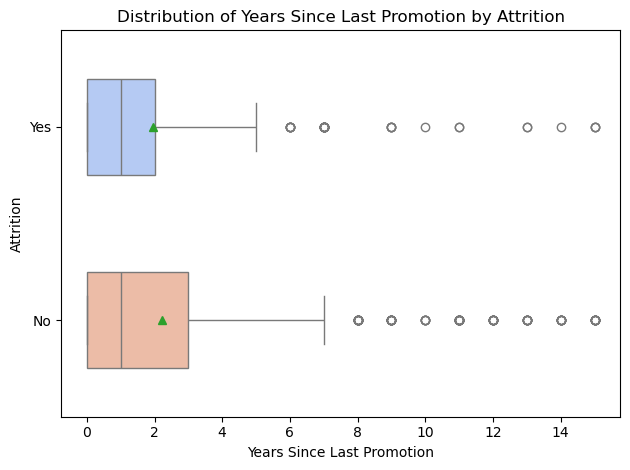

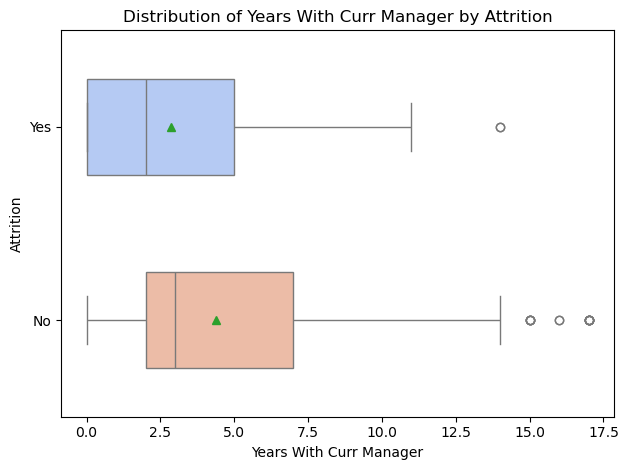

In [49]:
for column in df_num.columns:
    #print(column)
    plot_boxplot(column)

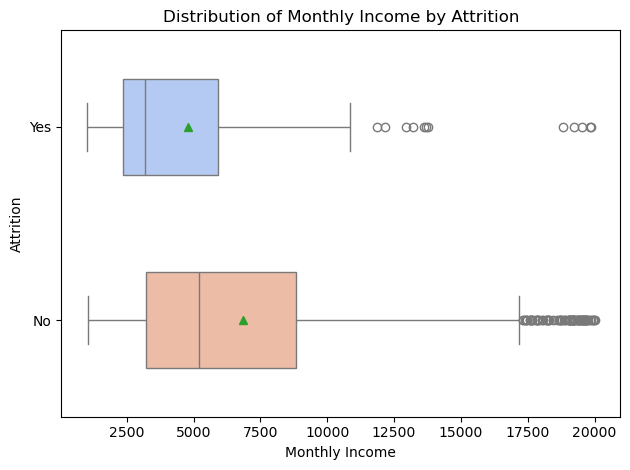

In [50]:
plot_boxplot('MonthlyIncome')

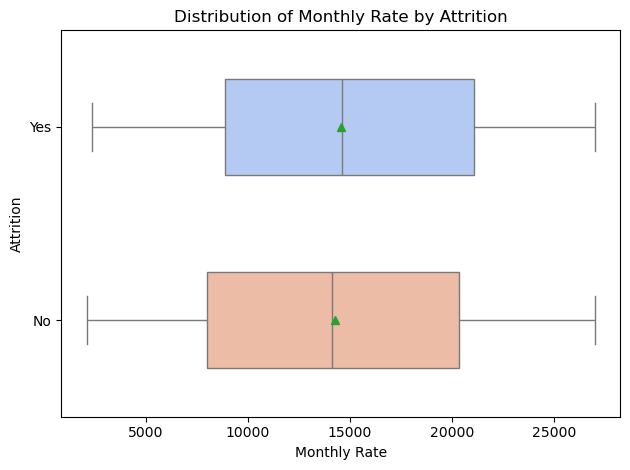

In [51]:
plot_boxplot('MonthlyRate')

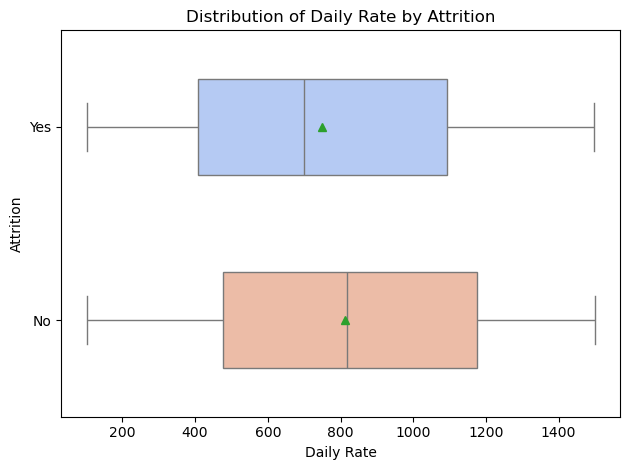

In [52]:
plot_boxplot('DailyRate')

#### Income-Related Insight:

Lower Monthly Income (actual) correlates with higher attrition

Monthly Rates of pay (theoretical) are similar between groups

Actual earnings rather than pay rates may be a stronger influencer


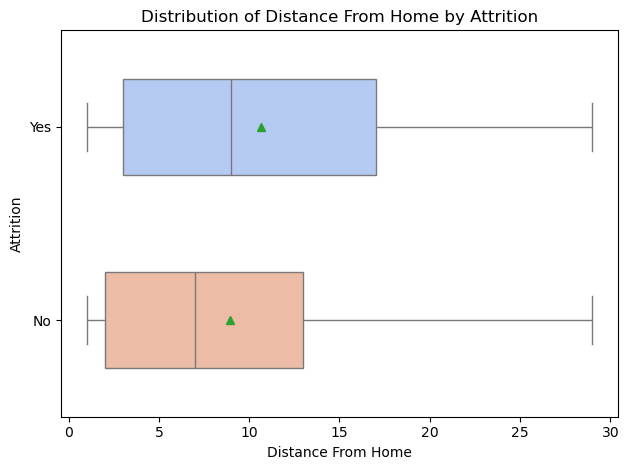

In [53]:
plot_boxplot('DistanceFromHome')

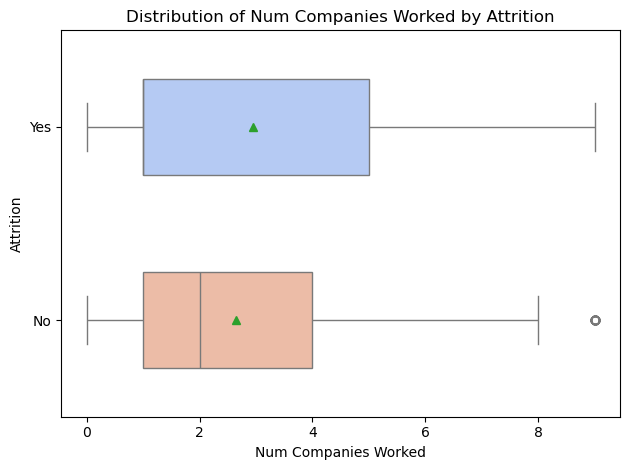

In [54]:
plot_boxplot('NumCompaniesWorked')

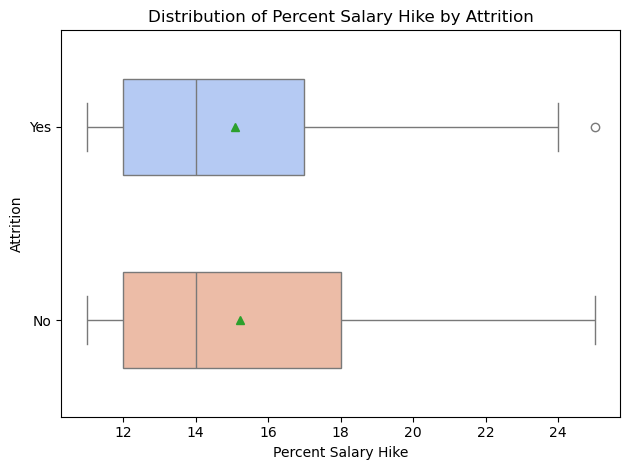

In [55]:
plot_boxplot('PercentSalaryHike')

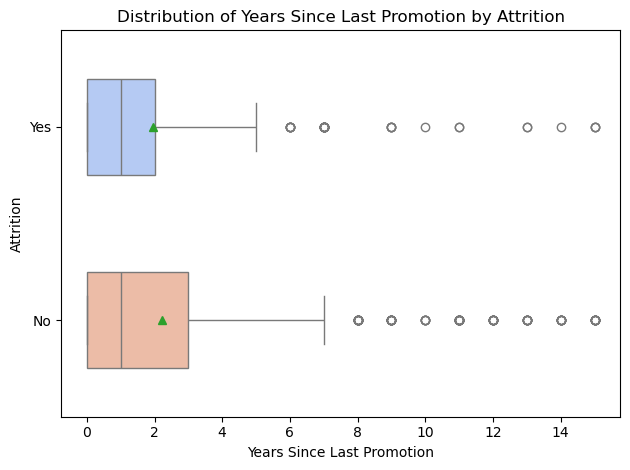

In [56]:
plot_boxplot('YearsSinceLastPromotion')

#### Strategies for Staff Retention (e.g. Salary Hike & Promotion)?

1.Salary increases alone might not be enough to keep people.

2.Half of the people who left got promoted within the past 2 years -The company might want to investigate why recently promoted employees are leaving

*Individual factors likely play a crucial role, suggesting the need for personalised retention strategies

In [57]:
def plot_hist_trend(feature, data=df, target='Attrition', target_class='Yes'):
    """
    Creates a combined plot with a histogram on the primary y-axis and a scatter on the secondary y-axis.

    Inputs:
      feature (str): The name of the feature variable to be used on the x-axis.
      data (pandas.DataFrame): The input DataFrame containing the data (default: df).      
      target (str, optional): The name of the target variable to be visualized (default: 'Attrition').
      target_class (str, optional): The specific class within the target variable to plot (default: 'Yes').
    """

    fig, ax1 = plt.subplots(figsize=(10, 6))

    # Plot histogram on primary y-axis (density for better comparison)
    #sns.histplot(ax=ax1, data=df, x=feature, hue=target, element='step', stat='density', common_norm=False, palette='viridis')
    sns.histplot(data=data, x=feature, 
                 hue=target, 
                 palette='viridis', 
                 edgecolor='white', 
                 alpha=0.3)
    ax1.set_xlabel(split_words(feature))
    ax1.set_ylabel('Count')
    ax1.tick_params(axis='y')  # Keep ticks on primary y-axis

    # Create a secondary y-axis for the trend line
    ax2 = ax1.twinx()

    
    # Calculate percentage by feature
    pct_by_feature = data.groupby(feature)[target].value_counts(normalize=True).unstack().reset_index()
    # Convert to percentage and round to one decimal place
    pct_by_feature[target_class] = (pct_by_feature[target_class] * 100).round(1)

    # Plot scatter points on secondary y-axis (to show percentage)
    sns.scatterplot(ax=ax2, x=feature, y=target_class, data=pct_by_feature,  s=50)
    #sns.regplot(ax=ax2, x=feature, y=target_class, data=pct_by_feature, ci=0)
    ax2.set_ylabel(f'{target} (%)')
    ax2.tick_params(axis='y')  # Keep ticks on secondary y-axis

    # Set title for the combined plot
    plt.title(f'{split_words(feature)} Distribution by {target} with Percentage')
    plt.grid(True)
    plt.show()


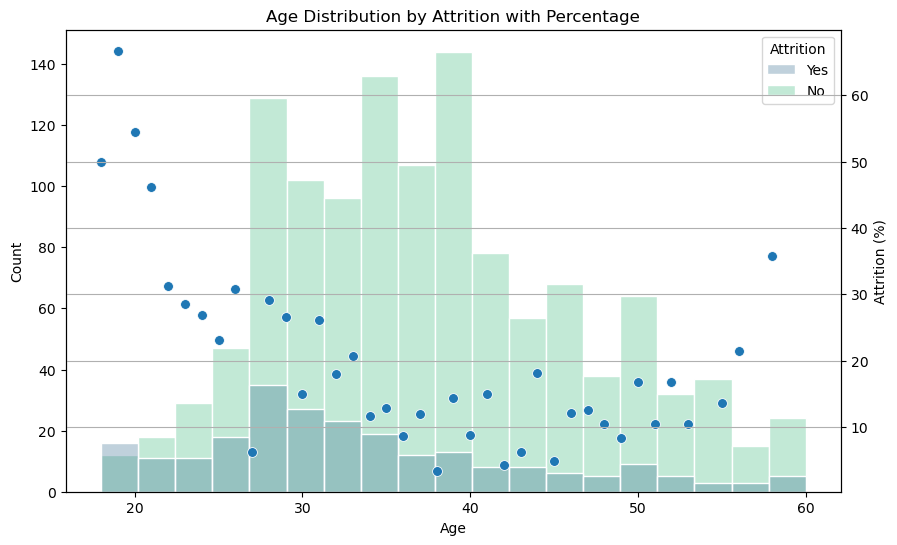

In [58]:
plot_hist_trend('Age')

#### Age Insight:

Highest attrition among youngest employees

General trend of decreasing attrition with age

Lowest attrition rates for employees in 30s and 40s

Slight increase in attrition for employees in late 50s


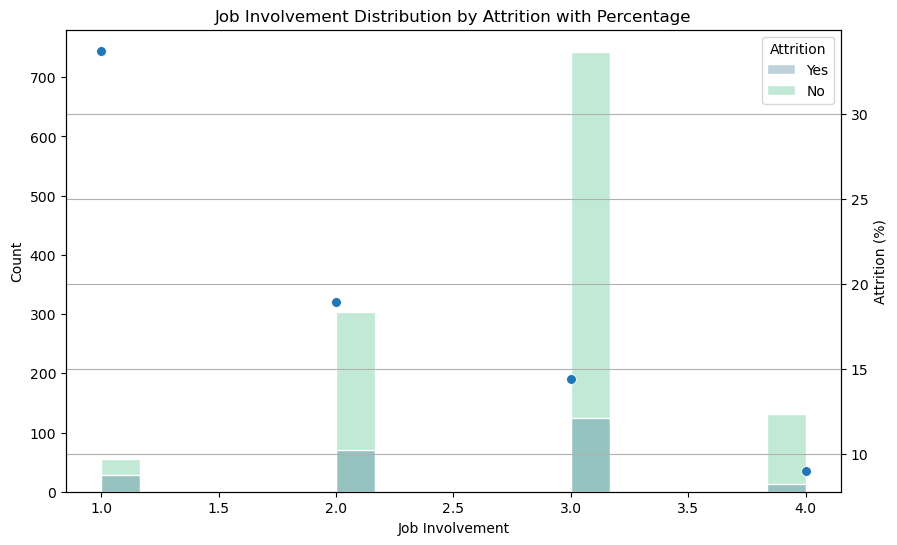

In [59]:
plot_hist_trend('JobInvolvement')

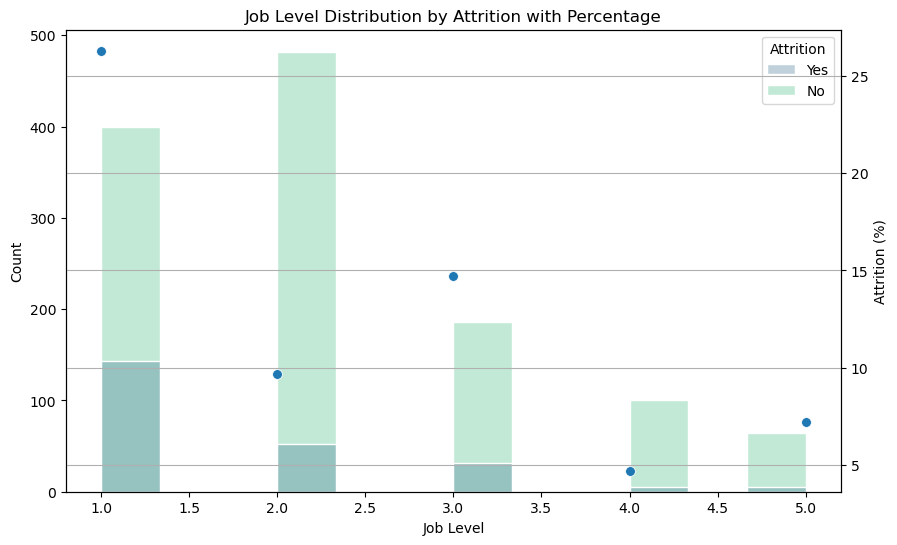

In [60]:
plot_hist_trend('JobLevel')

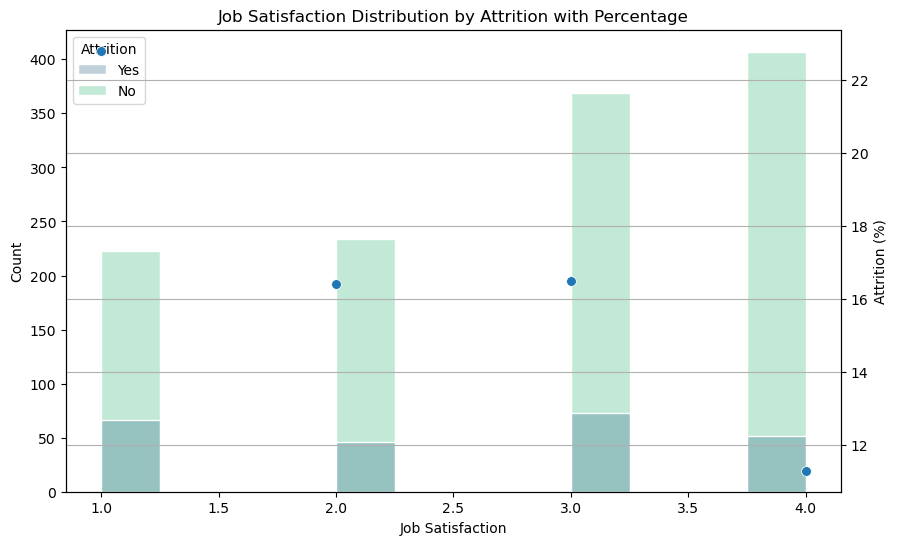

In [61]:
plot_hist_trend('JobSatisfaction')

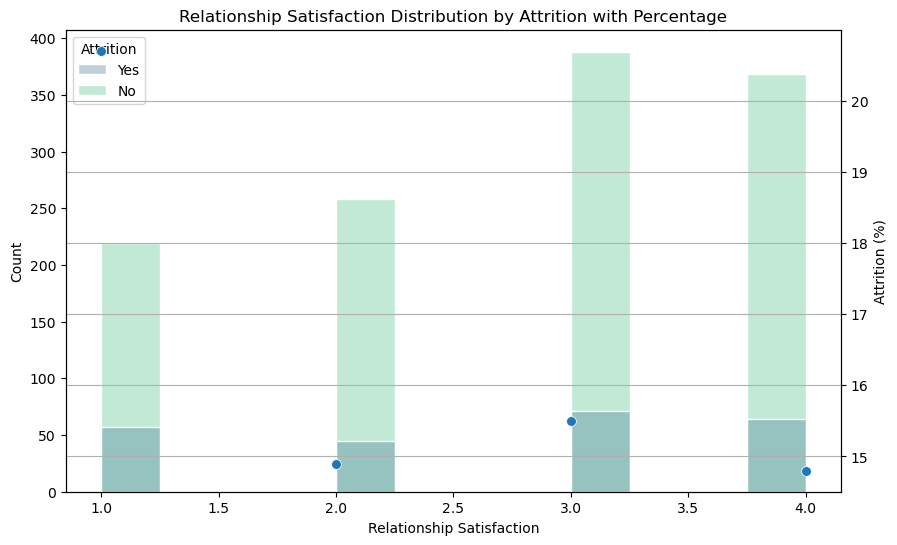

In [62]:
plot_hist_trend('RelationshipSatisfaction')

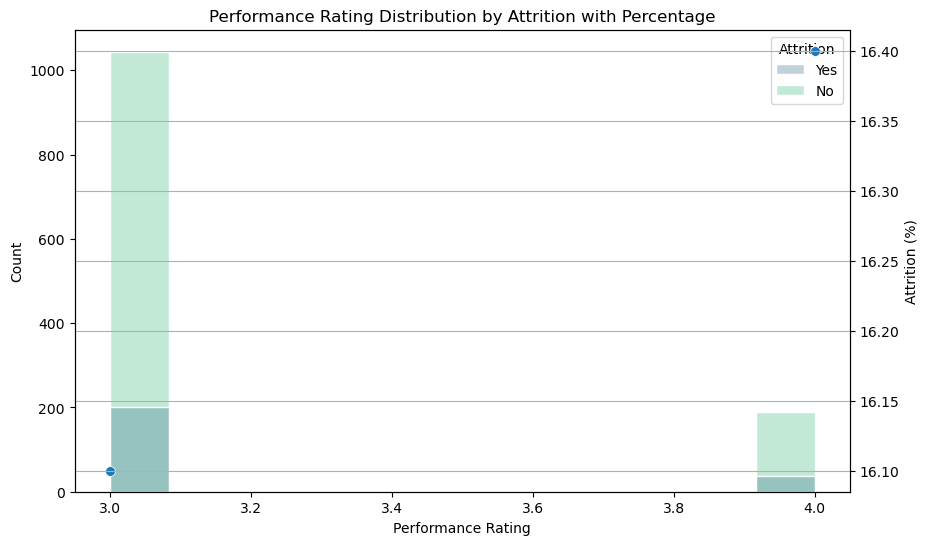

In [63]:
plot_hist_trend('PerformanceRating')

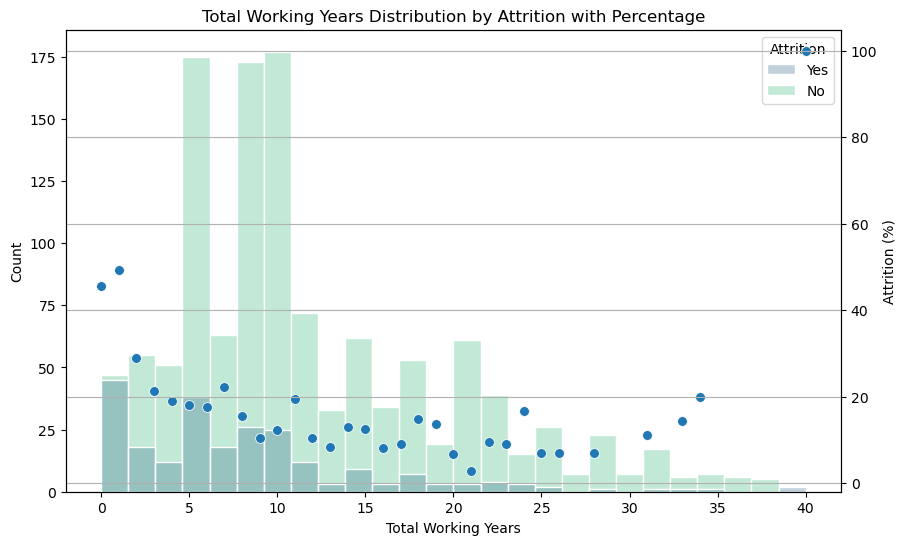

In [64]:
plot_hist_trend('TotalWorkingYears')

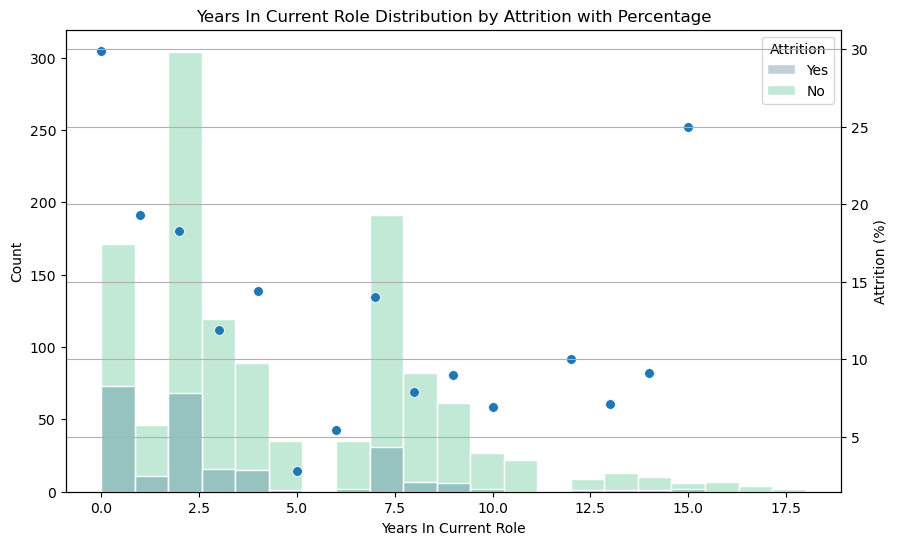

In [65]:
plot_hist_trend('YearsInCurrentRole')

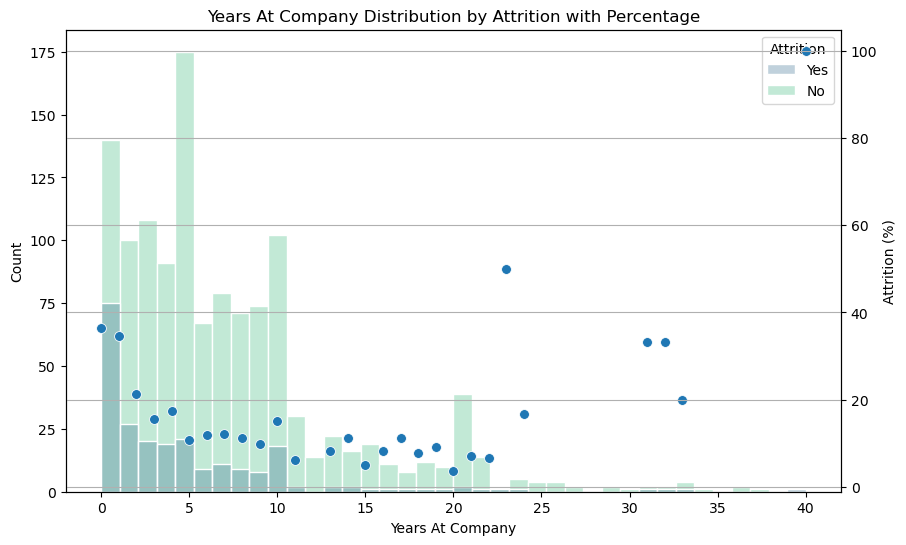

In [66]:
plot_hist_trend('YearsAtCompany')

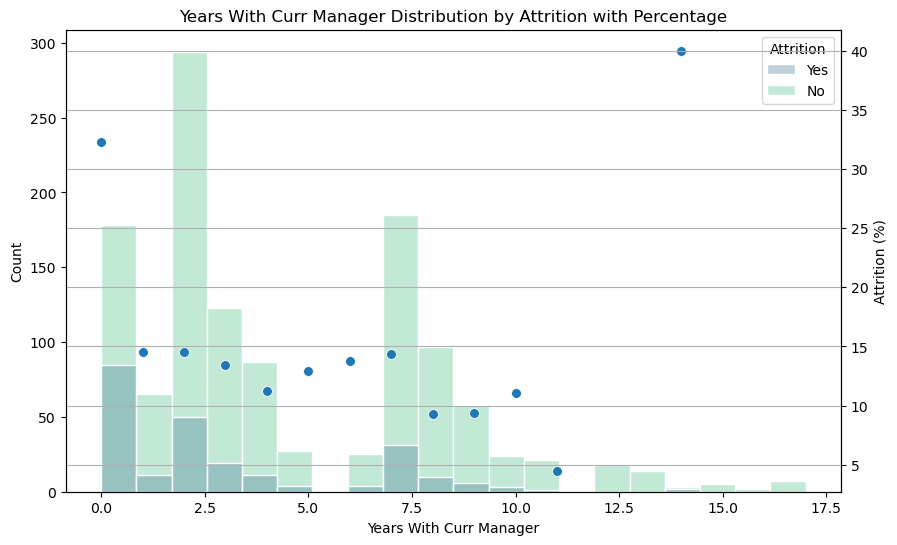

In [67]:
plot_hist_trend('YearsWithCurrManager')

#### Years of Service Insights:

For years with company / manager / current role:

Attrition generally appears to decrease as tenure increases, whether in total experience, company service, or time with a current manager/role. 

However, it's important to note that for longer tenure categories, the sample size of employees who left becomes quite small. This limited data in these categories may not provide statistically significant results and should be interpreted cautiously.


In [68]:
def plot_lines(x_feature, y_feature='MonthlyIncome', data=df, category='Attrition' ):
    plt.figure(figsize=(10,6))
    sns.lineplot(data=data, x=x_feature, y=y_feature, 
                 hue=category, 
                 palette='viridis',
                 alpha=0.7,
                 errorbar=('ci', 0)                 
                )
    
    plt.xlabel(split_words(x_feature))
    plt.ylabel('Average ' + split_words(y_feature))
    plt.title(f'Compare Average {split_words(y_feature)} by {split_words(x_feature)} and {split_words(category)}')
    plt.grid(True)
    plt.show()

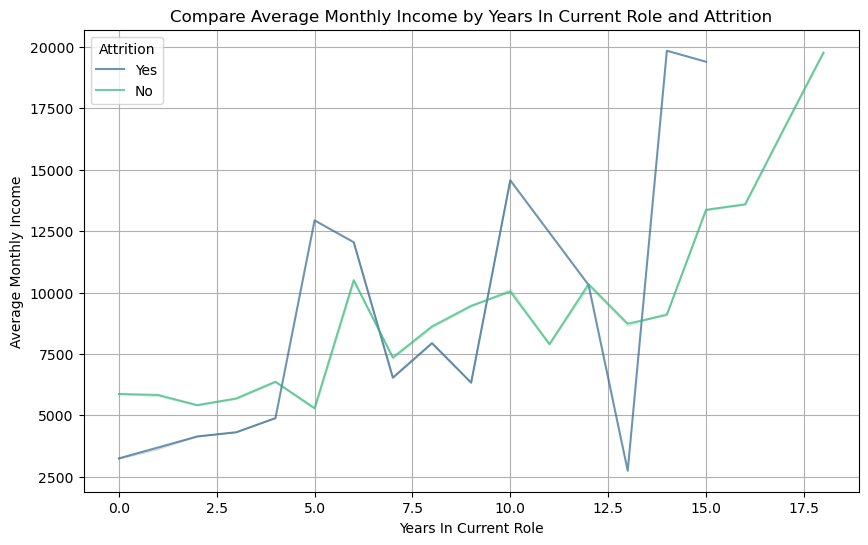

In [69]:
plot_lines('YearsInCurrentRole')

# Hypothesis Testing

## Null Hypothesis:

There is no difference between the employees who have left (Attrition-Yes) and those who stay in the company (Attrtition-No)

In [70]:
N = 100 # sample size

df_left = df[df['Attrition'] == 'Yes'].sample(N, random_state=42)
df_stayed = df[df['Attrition'] == 'No'].sample(N, random_state=42)

alpha = 0.05


In [71]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

In [72]:
feature = 'Age'

In [73]:
a = df_left[feature]
b = df_stayed[feature]

In [74]:
def print_sig(p_value, alpha):
    if p_value < alpha:
        print("We reject our null hypothesis.")
    else:
        print("We fail to reject our null hypothesis.")

In [75]:
## 
t, p = stats.ttest_ind(a,b)
print("t = " + str(t))
print("p = " + str(p))

print_sig(p, alpha)

t = -1.7286729567900474
p = 0.08542646963102565
We fail to reject our null hypothesis.


In [76]:
def stat_test(feature, alpha_value=0.05):
    
    a = df_left[feature]
    b = df_stayed[feature]

    t, p = stats.ttest_ind(a,b)
    print("t = " + str(t))
    print("p = " + str(p))
    
    print_sig(p, alpha_value)

    if p < alpha_value: # Reject the null hypothesis
        return feature

In [77]:
stat_test('DistanceFromHome')

t = 2.4770885410322268
p = 0.01408379153088815
We reject our null hypothesis.


'DistanceFromHome'

In [78]:
stat_test('Education')

t = -0.5541890880578096
p = 0.5800748196436083
We fail to reject our null hypothesis.


In [79]:
stat_test('MonthlyIncome', 0.01)

t = -3.739252793246495
p = 0.00024156626600389577
We reject our null hypothesis.


'MonthlyIncome'

In [80]:
num_columns = ['Age',  'DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked',  'PercentSalaryHike',
       'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager']

features_reject_null = []

for feature in num_columns:
    print(f'Stats test result for {split_words(feature)}:')
    #stat_test(feature)
    features_reject_null.append(stat_test(feature))
    print('')

print('Features to reject null hypothesis:')
for feature in features_reject_null:
    if feature != None:
        print(split_words(feature))


Stats test result for Age:
t = -1.7286729567900474
p = 0.08542646963102565
We fail to reject our null hypothesis.

Stats test result for Daily Rate:
t = -0.7962934209028977
p = 0.42681520892463176
We fail to reject our null hypothesis.

Stats test result for Distance From Home:
t = 2.4770885410322268
p = 0.01408379153088815
We reject our null hypothesis.

Stats test result for Education:
t = -0.5541890880578096
p = 0.5800748196436083
We fail to reject our null hypothesis.

Stats test result for Employee Number:
t = 0.07514123455708377
p = 0.9401782040392104
We fail to reject our null hypothesis.

Stats test result for Environment Satisfaction:
t = -1.6286670870317526
p = 0.10497354736079292
We fail to reject our null hypothesis.

Stats test result for Hourly Rate:
t = -0.07609309621121178
p = 0.9394218630518044
We fail to reject our null hypothesis.

Stats test result for Job Involvement:
t = -2.693638111274379
p = 0.007674121898943689
We reject our null hypothesis.

Stats test result 

## Summary:

### Features for us to reject our null hypothesis include:

DistanceFromHome

JobInvolvement

JobLevel

MonthlyIncome

NumCompaniesWorked

TotalWorkingYears

YearsAtCompany

YearsInCurrentRole

YearsWithCurrManager